## Image Captioning - LSTM Attention

In [1]:
import os
from pathlib import Path
#import spacy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import zipfile
#from PIL import Image
from collections import Counter
import sys
import random
from nltk.translate.bleu_score import sentence_bleu

#PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
#from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, random_split

#Vision
import torchvision.transforms as T
#import torchvision.models as models

#Torchtext
#import torchtext; torchtext.disable_torchtext_deprecation_warning() #supress warning
from torchtext.vocab import vocab
#from torchtext.data.utils import get_tokenizer


import nltk
nltk.download('wordnet')


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\SH2\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

For reproducibility:

In [2]:
def set_seed(seed):
    random.seed(seed)  #Python random module
    np.random.seed(seed)  #NumPy random module
    torch.manual_seed(seed)  #PyTorch CPU
    torch.cuda.manual_seed(seed)  #PyTorch GPU
    torch.cuda.manual_seed_all(seed)  #Multi-GPU setups
    torch.backends.cudnn.deterministic = True  #Deterministic behavior
    torch.backends.cudnn.benchmark = False  #Reproducibility

set_seed(46)

In [3]:
#Run if needed
# with zipfile.ZipFile('data/archive.zip') as z_temp:
#     z_temp.extractall(path='data/')

Check path to the image files and caption file:

In [4]:
current_dir = Path.cwd()

if current_dir.name == 'notebooks':
    project_root = current_dir.parent
else:
    project_root = current_dir

if project_root not in sys.path:
    sys.path.append(str(project_root))

captions_path = project_root / 'data' / 'flickr30k_images' / 'results.csv'
single_captions_path = project_root / 'data' / 'flickr30k_images' / 'single_captions_results.csv'
image_dir = project_root  / 'data' / 'flickr30k_images' / 'flickr30k_images'
image_paths = list(image_dir.glob('*.jpg'))

if captions_path.exists():
    print("Caption path exists")
else:
    print("Caption path does not exist")

if image_dir.exists() and image_dir.is_dir():
    print("Image directory exists")
    
    if image_paths:
        print(f"Found {len(image_paths)} images in the directory.")
    else:
        print("No images found in the directory.")
else:
    print("Image directory does not exist")


Caption path exists
Image directory exists
Found 31783 images in the directory.


Check caption.txt file and get the random raws (7 samples) from it

In [5]:
image_captions = pd.read_csv(captions_path, sep='|')
image_captions.columns = image_captions.columns.str.strip()
image_captions.sample(7)

,image_name,comment_number,comment
68478,3382777250.jpg,3,A child in a striped shirt is standing in fro...
11402,170525554.jpg,2,A man in black shirt is taking pictures in a ...
138363,5812770731.jpg,3,A young female baseball player slides to home...
27114,2385034500.jpg,4,Bikers ride down a busy rural street .
65696,3328380165.jpg,1,A man in sunglasses is sitting on top of a pl...
145877,6839984356.jpg,2,A youth wearing yellow sits on a wall holding...
100312,4467634558.jpg,2,Three children pose for a photograph by a rock .


In [6]:
#Handeling device selection
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

Using en_core_web_lg to built vocabulary for our captions. WE are also adding special tokens UNK_TOKEN = 'unk', PAD_TOKEN = 'pad', SOS_TOKEN = 'sos', EOS_TOKEN = 'eos' to our vocabulary:

In [7]:
from src.vocab_builder import VocabularyBuilder

#Replace non-string values with empty string
image_captions['comment'] = image_captions['comment'].apply(lambda x: x if isinstance(x, str) else '')
text_lines = image_captions['comment'].tolist()

if Path.cwd().name == 'notebooks':
    os.chdir("..")

#Uncomment or comment if you want to load or build/save
vocab_builder = VocabularyBuilder(min_freq=2, save_path='./saved_model/vocab_full.pth', special_token=True)
#vocab = vocab_builder.build_vocab(text_lines)
vocab = vocab_builder.load_vocab(device)


In [8]:
words = vocab.get_itos()
#print("Words in our vocab:", words)

vocab_length = len(vocab)
print(f"Total number of words in vocab: {vocab_length}")

Total number of words in vocab: 12102


Creating our dataset instance:

In [9]:
from src.image_caption_dataset import ImageCaptionDataset

mean = torch.tensor([0.485, 0.456, 0.406])
std = torch.tensor([0.229, 0.224, 0.225])

transforms = T.Compose([
    T.Resize((224, 224)), 
    T.ToTensor(),
    T.Normalize(mean=mean, std=std)
])


flickr_dataset =  ImageCaptionDataset(
    image_paths = image_paths,
    captions = captions_path,
    vocabulary_builder=vocab_builder,
    transform = transforms
)

In [10]:
# all_tokens = []
# caption_lengths = []
# max_caption_len = 0

# for caption in flickr_dataset.captions:
#     tokens = vocab_builder.spacy_tokenizer(caption)
#     all_tokens.extend(tokens)
#     caption_len = len(tokens)
#     caption_lengths.append(caption_len)
#     max_caption_len = max(max_caption_len, caption_len)

# print("Most common tokens in dataset:")
# print(Counter(all_tokens).most_common(10))
# print(f"Maximum caption length in dataset: {max_caption_len}")

# length_counts = Counter(caption_lengths)
# print("Caption length distribution:")
# print(length_counts)

# plt.figure(figsize=(10, 6))
# plt.bar(length_counts.keys(), length_counts.values(), color='blue', alpha=0.7)
# plt.xlabel('Caption Length', fontsize=14)
# plt.ylabel('Frequency', fontsize=14)
# plt.title('Caption Length Distribution', fontsize=16)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

In [11]:
max_sentence_length = 78

Normalized Image:


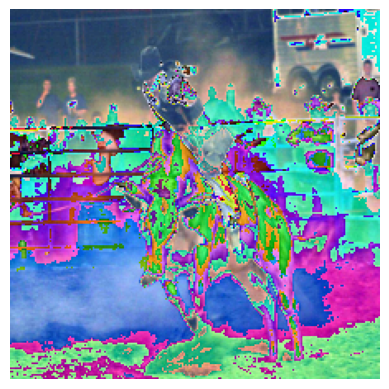

Denormalized Image:


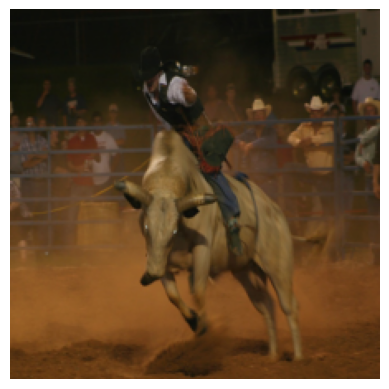

tensor([   2,   31,   32,   70,  911,  860,   50,   18, 5429,  778,   70,  527,
         710,   31, 3697,    3])
Caption :
<sos> a man is being thrown from the bull he is riding during a rodeo <eos>


In [12]:
from src.utils import display_image

img, ids, cap_text = flickr_dataset[10366]
print("Normalized Image:")
display_image(img, denormalize=False)
print("Denormalized Image:")
display_image(img, denormalize=True, mean=mean, std=std)
print(ids)
print('Caption :')
print(vocab_builder.token_ids_to_caption(ids))

Defining dataloader for our dataset and also split dataset into train and test sets (80% train, 20% test)

In [13]:
train_size = int(0.8 * len(flickr_dataset))
val_size = int(0.1 * len(flickr_dataset))
test_size = len(flickr_dataset) - train_size - val_size

train_dataset, val_dataset, test_dataset = random_split(
    flickr_dataset, [train_size, val_size, test_size]
)

In [14]:
print(f"Number of training samples: {train_size}")
print(f"Number of validation samples: {val_size}")
print(f"Number of test samples: {test_size}")


Number of training samples: 127131
Number of validation samples: 15891
Number of test samples: 15892


In [15]:
from src.batch_caption_collator import BatchCaptionCollator

pad_idx = vocab_builder.vocabulary['<pad>']
batch_size = 128
num_workers = 4
prefetch_factor = 2

collator = BatchCaptionCollator(pad_idx=pad_idx, max_len=max_sentence_length, batch_first=True)


train_loader = DataLoader(
    dataset=train_dataset,
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collator,
    num_workers=num_workers,
    prefetch_factor=prefetch_factor
)

val_loader = DataLoader(
    dataset=val_dataset,
    batch_size=batch_size,
    shuffle=False,
    collate_fn=collator,
    num_workers=num_workers,
    prefetch_factor=prefetch_factor
)

test_loader = DataLoader(
    dataset=test_dataset,
    batch_size=batch_size,
    shuffle=False,
    collate_fn=collator,
    num_workers=num_workers,
    prefetch_factor=prefetch_factor
)


## LSTM With Attention

### Different Hyperparameter - dec_hidden_size=1024, Attention Size=256

In [ ]:
vocab_size = len(vocab_builder.vocabulary)

emb_size = 300

attn_size = 256
drop_prob = 0.3
enc_hidden_size = 2048
dec_hidden_size = 1024

learning_rate = 1e-3
num_epochs = 100
print_every = 400

weight_decay = 1e-5

backbone="resnet50"  #"efficientnet"

transformation=None

save_dir = "saved_model"

In [17]:
from src.models.encoderdecoder import EncoderDecoder

model_Attention = EncoderDecoder(
    emb_size = emb_size,
    vocab_size = vocab_size,
    attn_size = attn_size,
    enc_hidden_size = enc_hidden_size,
    dec_hidden_size = dec_hidden_size,
    drop_prob = drop_prob,
    device = device,
    use_attention=True,
    transformation=transformation
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index = vocab['<pad>'])
optimizer = optim.Adam(model_Attention.parameters(), lr = learning_rate, weight_decay=weight_decay)

In [18]:
from src.utils import EarlyStopping

earlystopping_patience = 4

LR_patience = 2
LR_factor = 0.1


early_stopping = EarlyStopping(patience=earlystopping_patience, min_delta=0.001)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=LR_factor, patience=LR_patience, verbose=True)

Epoch: 1, Batch: 400, Training Loss: 3.75715


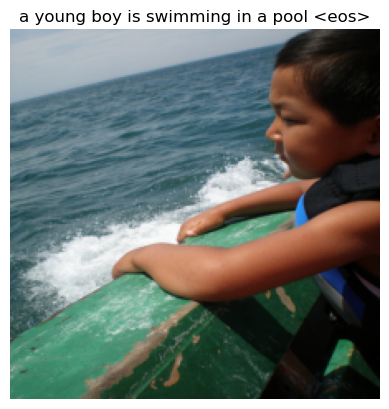

Epoch: 1, Batch: 800, Training Loss: 3.30806


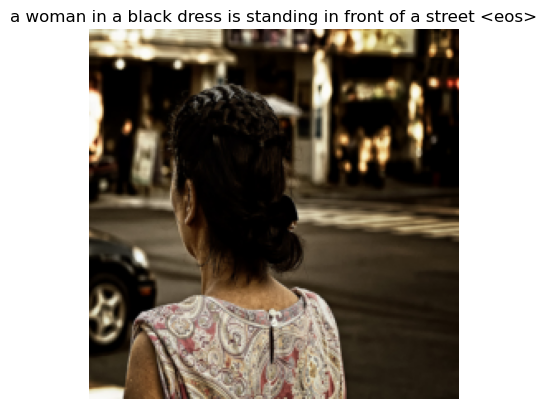

Epoch 1/100 - Train Loss: 3.7057, Val Loss: 3.2057, BLEU: 0.0614, ROUGE-1 Precision: 0.3283, ROUGE-1 Recall: 0.3230, ROUGE-1 F1: 0.3108, ROUGE-2 Precision: 0.1065, ROUGE-2 Recall: 0.1027, ROUGE-2 F1: 0.0992, ROUGE-L Precision: 0.3006, ROUGE-L Recall: 0.2988, ROUGE-L F1: 0.2861
Saved checkpoint for epoch 1 at saved_model\LSTM_with_Attention_resnet50_None_epoch_1.pth.gz
Epoch: 2, Batch: 400, Training Loss: 3.13949


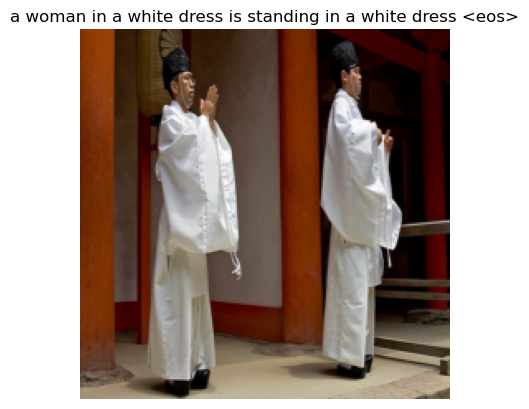

Epoch: 2, Batch: 800, Training Loss: 3.05228


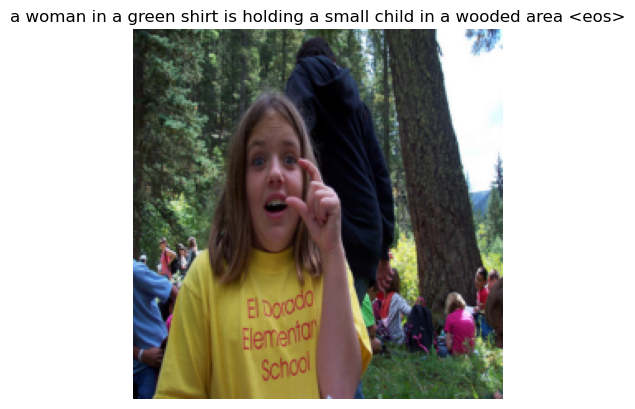

Epoch 2/100 - Train Loss: 3.0574, Val Loss: 3.0183, BLEU: 0.0637, ROUGE-1 Precision: 0.3359, ROUGE-1 Recall: 0.3318, ROUGE-1 F1: 0.3163, ROUGE-2 Precision: 0.1124, ROUGE-2 Recall: 0.1095, ROUGE-2 F1: 0.1044, ROUGE-L Precision: 0.3081, ROUGE-L Recall: 0.3072, ROUGE-L F1: 0.2914
Saved checkpoint for epoch 2 at saved_model\LSTM_with_Attention_resnet50_None_epoch_2.pth.gz
Epoch: 3, Batch: 400, Training Loss: 2.77064


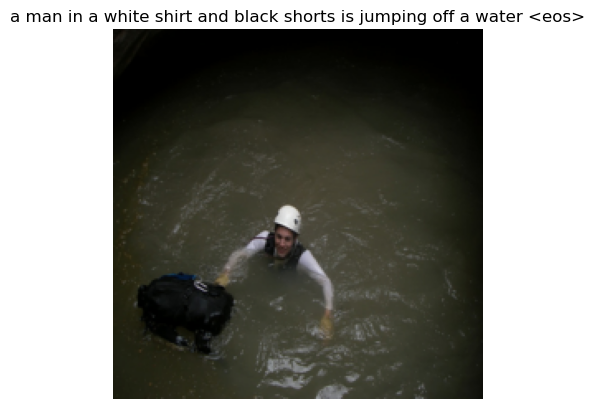

Epoch: 3, Batch: 800, Training Loss: 2.87693


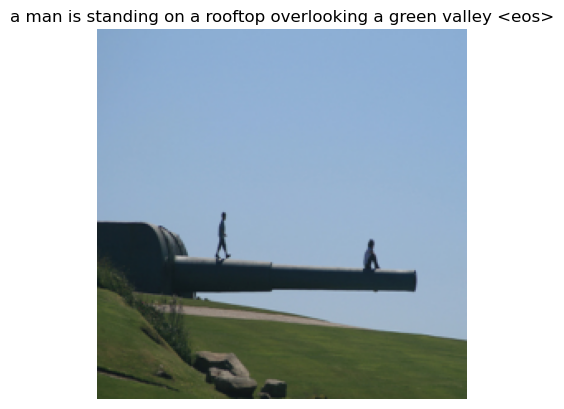

Epoch 3/100 - Train Loss: 2.8446, Val Loss: 2.9189, BLEU: 0.0715, ROUGE-1 Precision: 0.3783, ROUGE-1 Recall: 0.3399, ROUGE-1 F1: 0.3424, ROUGE-2 Precision: 0.1320, ROUGE-2 Recall: 0.1171, ROUGE-2 F1: 0.1181, ROUGE-L Precision: 0.3471, ROUGE-L Recall: 0.3141, ROUGE-L F1: 0.3153
Saved checkpoint for epoch 3 at saved_model\LSTM_with_Attention_resnet50_None_epoch_3.pth.gz
Epoch: 4, Batch: 400, Training Loss: 2.66563


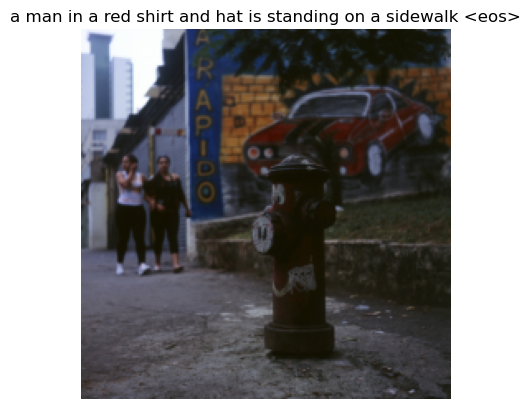

Epoch: 4, Batch: 800, Training Loss: 2.77273


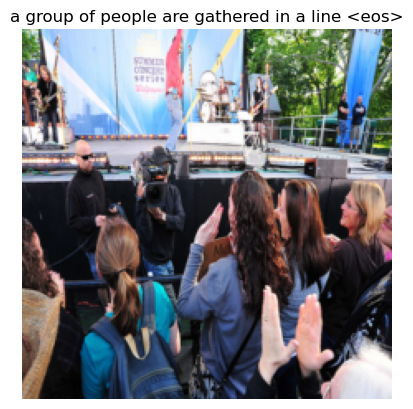

Epoch 4/100 - Train Loss: 2.6978, Val Loss: 2.8664, BLEU: 0.0767, ROUGE-1 Precision: 0.3809, ROUGE-1 Recall: 0.3507, ROUGE-1 F1: 0.3499, ROUGE-2 Precision: 0.1365, ROUGE-2 Recall: 0.1233, ROUGE-2 F1: 0.1236, ROUGE-L Precision: 0.3485, ROUGE-L Recall: 0.3236, ROUGE-L F1: 0.3215
Saved checkpoint for epoch 4 at saved_model\LSTM_with_Attention_resnet50_None_epoch_4.pth.gz
Epoch: 5, Batch: 400, Training Loss: 2.54676


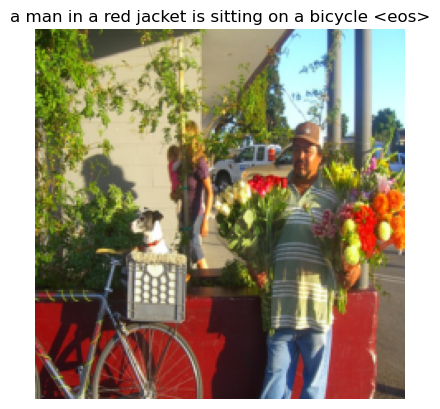

Epoch: 5, Batch: 800, Training Loss: 2.51524


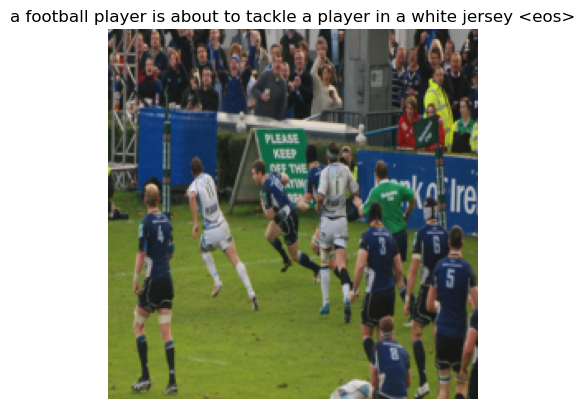

Epoch 5/100 - Train Loss: 2.5816, Val Loss: 2.8363, BLEU: 0.0778, ROUGE-1 Precision: 0.3702, ROUGE-1 Recall: 0.3589, ROUGE-1 F1: 0.3482, ROUGE-2 Precision: 0.1318, ROUGE-2 Recall: 0.1260, ROUGE-2 F1: 0.1225, ROUGE-L Precision: 0.3381, ROUGE-L Recall: 0.3306, ROUGE-L F1: 0.3193
Saved checkpoint for epoch 5 at saved_model\LSTM_with_Attention_resnet50_None_epoch_5.pth.gz
Epoch: 6, Batch: 400, Training Loss: 2.60979


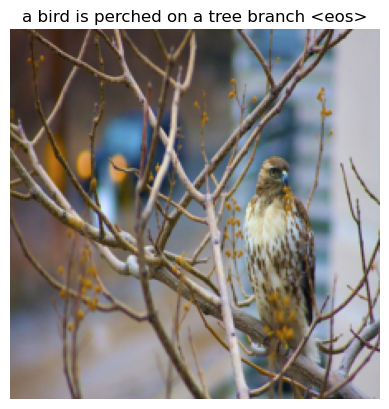

Epoch: 6, Batch: 800, Training Loss: 2.67244


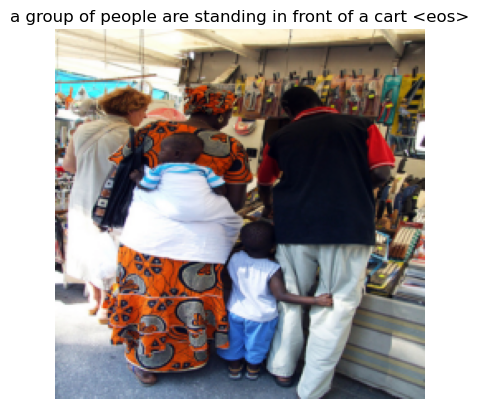

Epoch 6/100 - Train Loss: 2.4843, Val Loss: 2.8215, BLEU: 0.0777, ROUGE-1 Precision: 0.3924, ROUGE-1 Recall: 0.3555, ROUGE-1 F1: 0.3559, ROUGE-2 Precision: 0.1426, ROUGE-2 Recall: 0.1269, ROUGE-2 F1: 0.1274, ROUGE-L Precision: 0.3603, ROUGE-L Recall: 0.3291, ROUGE-L F1: 0.3281
Saved checkpoint for epoch 6 at saved_model\LSTM_with_Attention_resnet50_None_epoch_6.pth.gz
Epoch: 7, Batch: 400, Training Loss: 2.33885


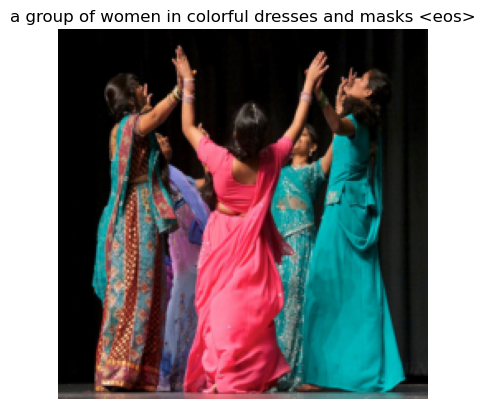

Epoch: 7, Batch: 800, Training Loss: 2.49798


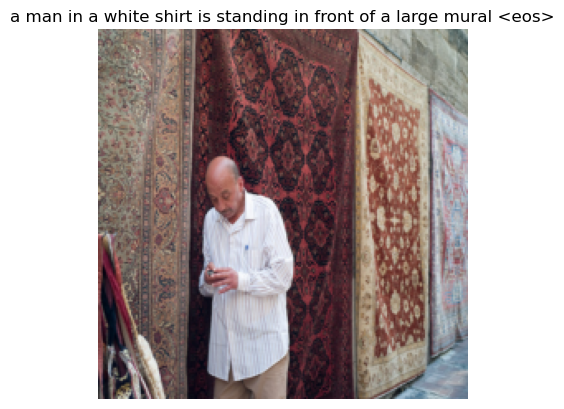

Epoch 7/100 - Train Loss: 2.4003, Val Loss: 2.8108, BLEU: 0.0815, ROUGE-1 Precision: 0.3904, ROUGE-1 Recall: 0.3646, ROUGE-1 F1: 0.3598, ROUGE-2 Precision: 0.1431, ROUGE-2 Recall: 0.1312, ROUGE-2 F1: 0.1301, ROUGE-L Precision: 0.3561, ROUGE-L Recall: 0.3349, ROUGE-L F1: 0.3293
Saved checkpoint for epoch 7 at saved_model\LSTM_with_Attention_resnet50_None_epoch_7.pth.gz
Epoch: 8, Batch: 400, Training Loss: 2.34318


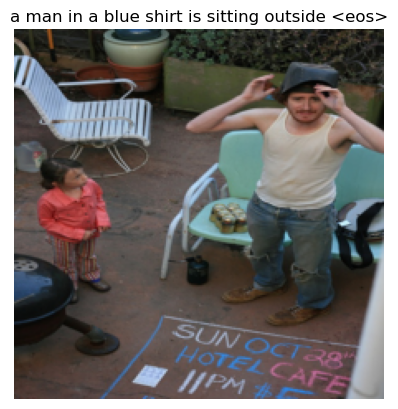

Epoch: 8, Batch: 800, Training Loss: 2.40055


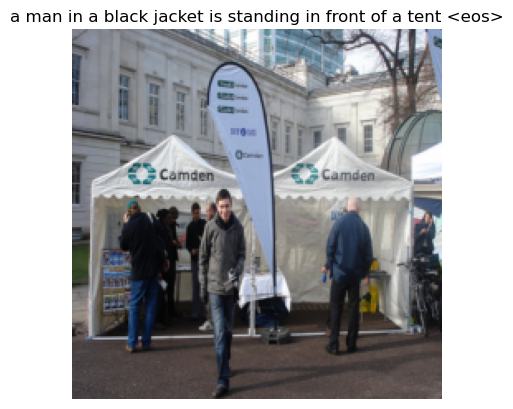

Epoch 8/100 - Train Loss: 2.3261, Val Loss: 2.8008, BLEU: 0.0836, ROUGE-1 Precision: 0.3987, ROUGE-1 Recall: 0.3700, ROUGE-1 F1: 0.3668, ROUGE-2 Precision: 0.1483, ROUGE-2 Recall: 0.1358, ROUGE-2 F1: 0.1348, ROUGE-L Precision: 0.3653, ROUGE-L Recall: 0.3414, ROUGE-L F1: 0.3372
Saved checkpoint for epoch 8 at saved_model\LSTM_with_Attention_resnet50_None_epoch_8.pth.gz
Epoch: 9, Batch: 400, Training Loss: 2.19063


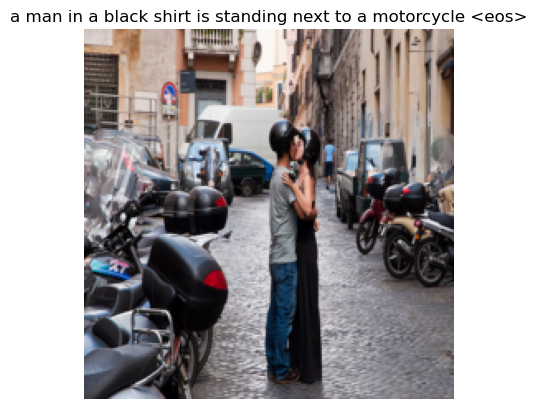

Epoch: 9, Batch: 800, Training Loss: 2.39045


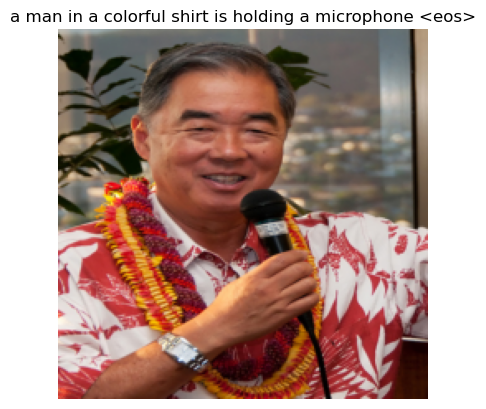

Epoch 9/100 - Train Loss: 2.2621, Val Loss: 2.7995, BLEU: 0.0838, ROUGE-1 Precision: 0.3917, ROUGE-1 Recall: 0.3793, ROUGE-1 F1: 0.3679, ROUGE-2 Precision: 0.1453, ROUGE-2 Recall: 0.1391, ROUGE-2 F1: 0.1350, ROUGE-L Precision: 0.3571, ROUGE-L Recall: 0.3482, ROUGE-L F1: 0.3365
Saved checkpoint for epoch 9 at saved_model\LSTM_with_Attention_resnet50_None_epoch_9.pth.gz
Epoch: 10, Batch: 400, Training Loss: 2.12967


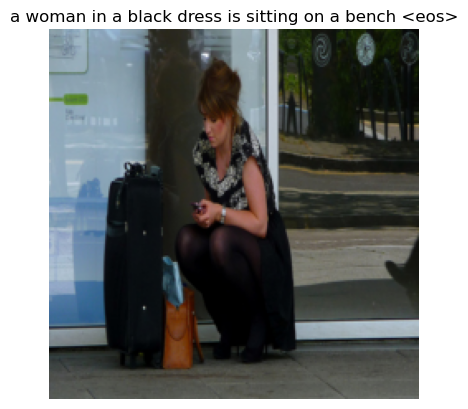

Epoch: 10, Batch: 800, Training Loss: 2.25346


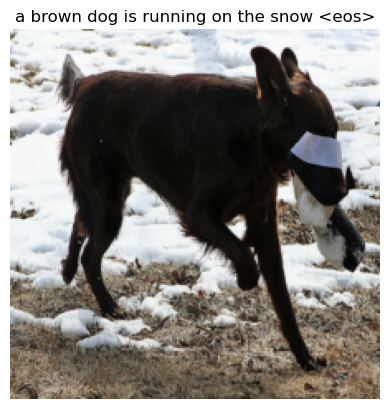

Epoch 10/100 - Train Loss: 2.1999, Val Loss: 2.8023, BLEU: 0.0853, ROUGE-1 Precision: 0.3976, ROUGE-1 Recall: 0.3785, ROUGE-1 F1: 0.3708, ROUGE-2 Precision: 0.1496, ROUGE-2 Recall: 0.1402, ROUGE-2 F1: 0.1377, ROUGE-L Precision: 0.3638, ROUGE-L Recall: 0.3486, ROUGE-L F1: 0.3403
Saved checkpoint for epoch 10 at saved_model\LSTM_with_Attention_resnet50_None_epoch_10.pth.gz
Epoch: 11, Batch: 400, Training Loss: 2.14651


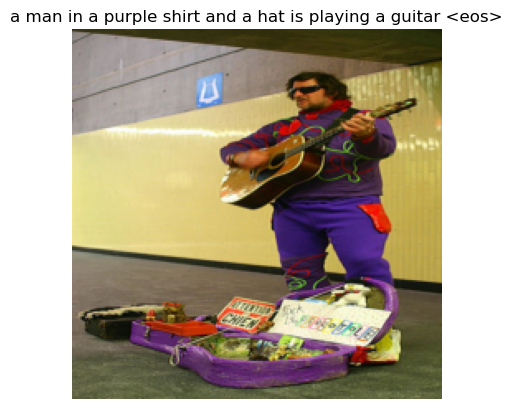

Epoch: 11, Batch: 800, Training Loss: 2.21623


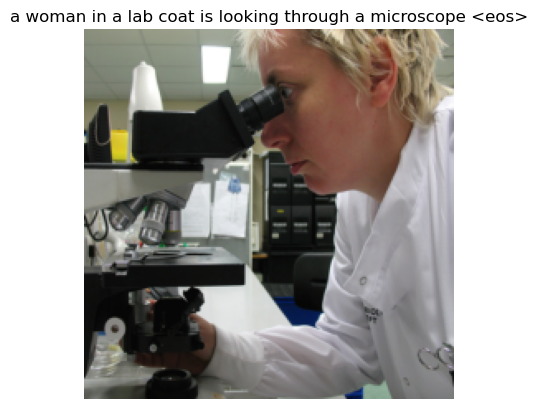

Epoch 11/100 - Train Loss: 2.1478, Val Loss: 2.8076, BLEU: 0.0874, ROUGE-1 Precision: 0.3954, ROUGE-1 Recall: 0.3810, ROUGE-1 F1: 0.3705, ROUGE-2 Precision: 0.1497, ROUGE-2 Recall: 0.1425, ROUGE-2 F1: 0.1387, ROUGE-L Precision: 0.3619, ROUGE-L Recall: 0.3508, ROUGE-L F1: 0.3400
Saved checkpoint for epoch 11 at saved_model\LSTM_with_Attention_resnet50_None_epoch_11.pth.gz
Epoch: 12, Batch: 400, Training Loss: 2.17540


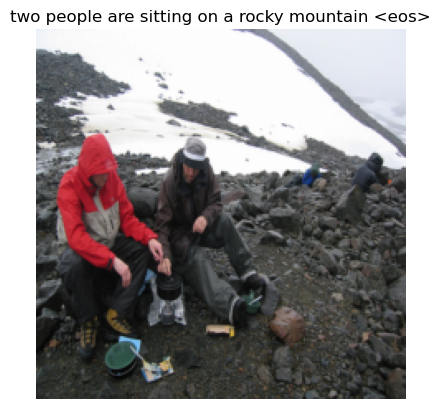

Epoch: 12, Batch: 800, Training Loss: 2.24535


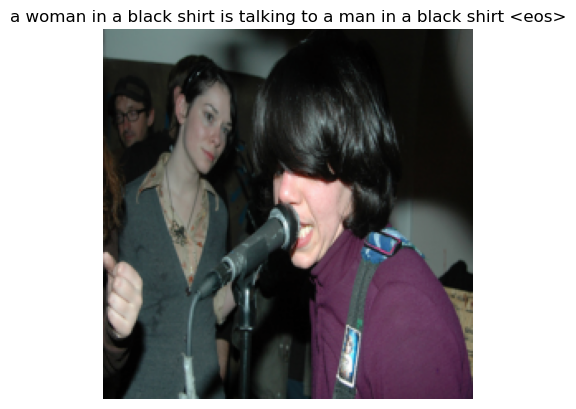

Epoch 12/100 - Train Loss: 2.0986, Val Loss: 2.8126, BLEU: 0.0844, ROUGE-1 Precision: 0.4099, ROUGE-1 Recall: 0.3763, ROUGE-1 F1: 0.3745, ROUGE-2 Precision: 0.1537, ROUGE-2 Recall: 0.1393, ROUGE-2 F1: 0.1389, ROUGE-L Precision: 0.3743, ROUGE-L Recall: 0.3460, ROUGE-L F1: 0.3432
Epoch 00012: reducing learning rate of group 0 to 1.0000e-04.
Saved checkpoint for epoch 12 at saved_model\LSTM_with_Attention_resnet50_None_epoch_12.pth.gz
Epoch: 13, Batch: 400, Training Loss: 1.86935


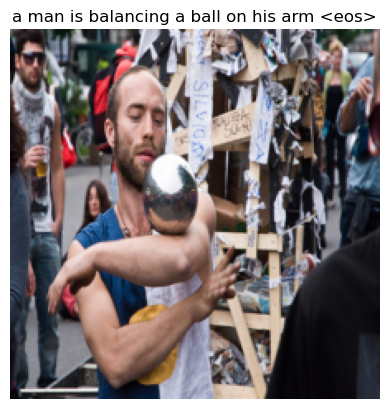

Epoch: 13, Batch: 800, Training Loss: 1.81998


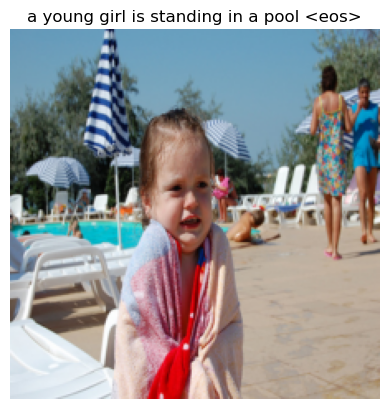

Epoch 13/100 - Train Loss: 1.8043, Val Loss: 2.7860, BLEU: 0.0908, ROUGE-1 Precision: 0.4164, ROUGE-1 Recall: 0.3915, ROUGE-1 F1: 0.3852, ROUGE-2 Precision: 0.1609, ROUGE-2 Recall: 0.1490, ROUGE-2 F1: 0.1470, ROUGE-L Precision: 0.3809, ROUGE-L Recall: 0.3603, ROUGE-L F1: 0.3534
Saved checkpoint for epoch 13 at saved_model\LSTM_with_Attention_resnet50_None_epoch_13.pth.gz
Epoch: 14, Batch: 400, Training Loss: 1.74898


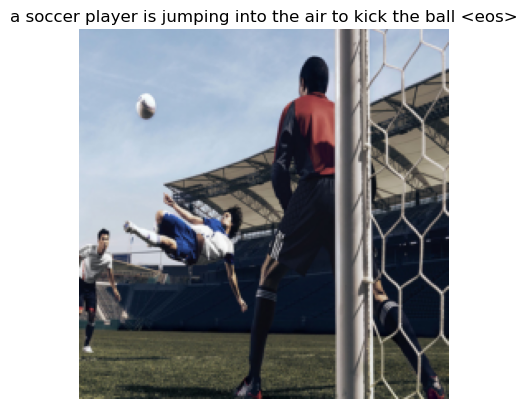

Epoch: 14, Batch: 800, Training Loss: 1.69016


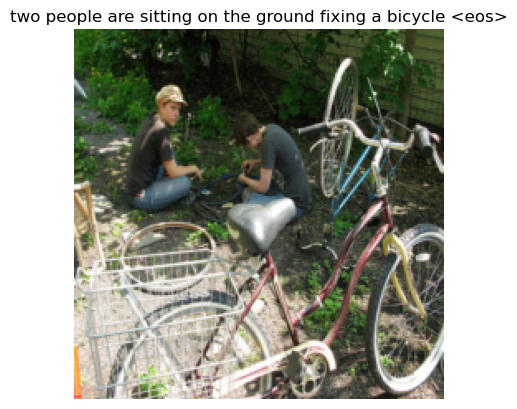

Epoch 14/100 - Train Loss: 1.7290, Val Loss: 2.7901, BLEU: 0.0933, ROUGE-1 Precision: 0.4196, ROUGE-1 Recall: 0.3967, ROUGE-1 F1: 0.3899, ROUGE-2 Precision: 0.1634, ROUGE-2 Recall: 0.1525, ROUGE-2 F1: 0.1502, ROUGE-L Precision: 0.3839, ROUGE-L Recall: 0.3651, ROUGE-L F1: 0.3577
Saved checkpoint for epoch 14 at saved_model\LSTM_with_Attention_resnet50_None_epoch_14.pth.gz
Epoch: 15, Batch: 400, Training Loss: 1.64010


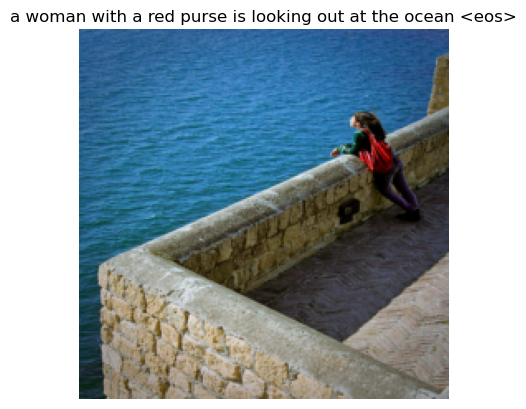

Epoch: 15, Batch: 800, Training Loss: 1.67613


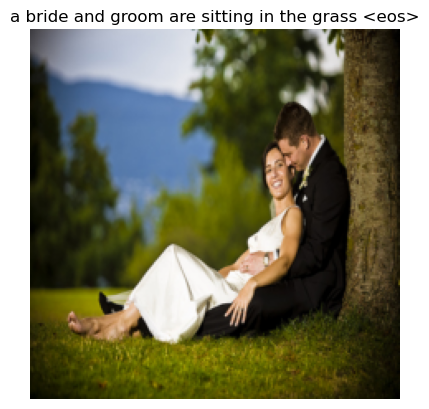

Epoch 15/100 - Train Loss: 1.6904, Val Loss: 2.7942, BLEU: 0.0917, ROUGE-1 Precision: 0.4215, ROUGE-1 Recall: 0.3959, ROUGE-1 F1: 0.3901, ROUGE-2 Precision: 0.1639, ROUGE-2 Recall: 0.1521, ROUGE-2 F1: 0.1501, ROUGE-L Precision: 0.3847, ROUGE-L Recall: 0.3634, ROUGE-L F1: 0.3570
Saved checkpoint for epoch 15 at saved_model\LSTM_with_Attention_resnet50_None_epoch_15.pth.gz
Epoch: 16, Batch: 400, Training Loss: 1.77817


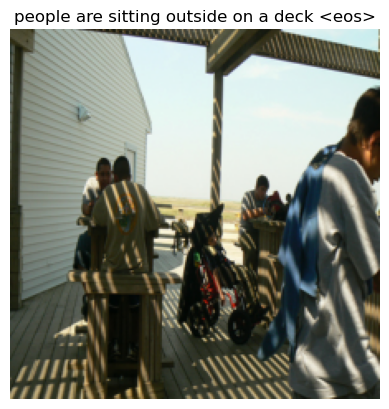

Epoch: 16, Batch: 800, Training Loss: 1.76666


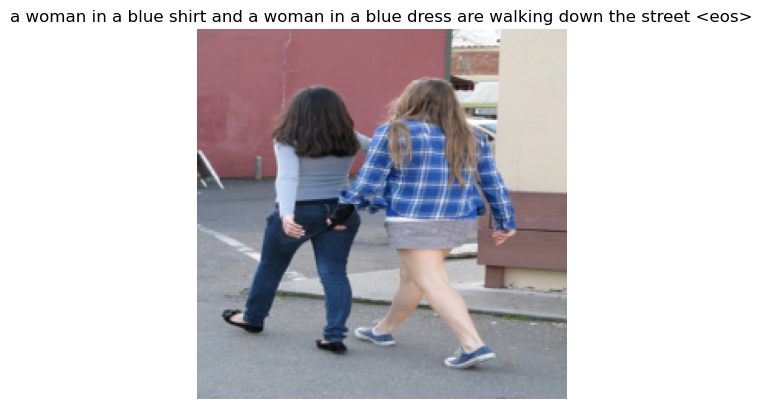

Epoch 16/100 - Train Loss: 1.6600, Val Loss: 2.8023, BLEU: 0.0934, ROUGE-1 Precision: 0.4212, ROUGE-1 Recall: 0.3975, ROUGE-1 F1: 0.3906, ROUGE-2 Precision: 0.1639, ROUGE-2 Recall: 0.1528, ROUGE-2 F1: 0.1503, ROUGE-L Precision: 0.3842, ROUGE-L Recall: 0.3645, ROUGE-L F1: 0.3572
Epoch 00016: reducing learning rate of group 0 to 1.0000e-05.
Saved checkpoint for epoch 16 at saved_model\LSTM_with_Attention_resnet50_None_epoch_16.pth.gz
Epoch: 17, Batch: 400, Training Loss: 1.58077


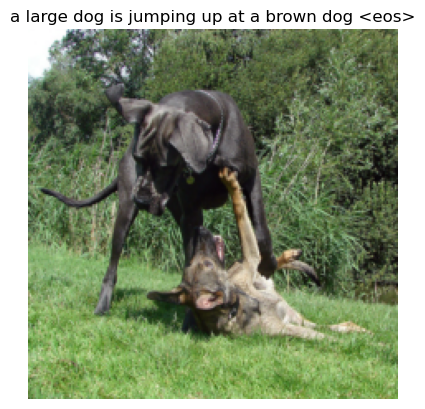

Epoch: 17, Batch: 800, Training Loss: 1.71137


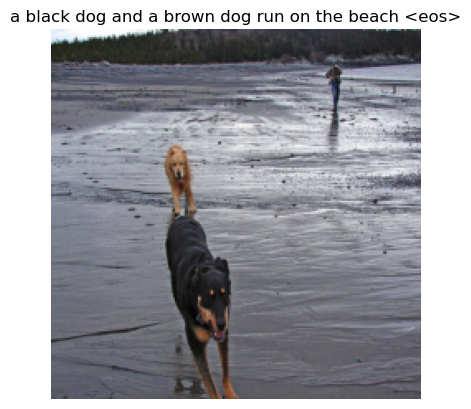

Epoch 17/100 - Train Loss: 1.6065, Val Loss: 2.8060, BLEU: 0.0940, ROUGE-1 Precision: 0.4197, ROUGE-1 Recall: 0.4001, ROUGE-1 F1: 0.3912, ROUGE-2 Precision: 0.1636, ROUGE-2 Recall: 0.1540, ROUGE-2 F1: 0.1508, ROUGE-L Precision: 0.3831, ROUGE-L Recall: 0.3674, ROUGE-L F1: 0.3581
Saved checkpoint for epoch 17 at saved_model\LSTM_with_Attention_resnet50_None_epoch_17.pth.gz
Epoch: 18, Batch: 400, Training Loss: 1.72557


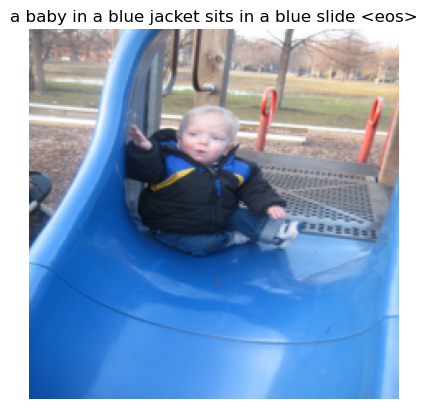

Epoch: 18, Batch: 800, Training Loss: 1.68352


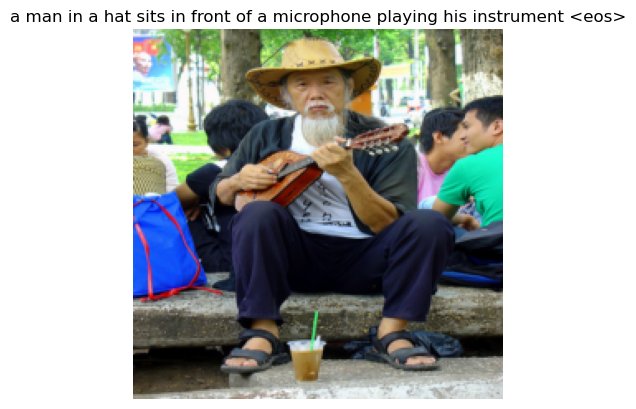

Epoch 18/100 - Train Loss: 1.6019, Val Loss: 2.8052, BLEU: 0.0941, ROUGE-1 Precision: 0.4201, ROUGE-1 Recall: 0.4002, ROUGE-1 F1: 0.3915, ROUGE-2 Precision: 0.1636, ROUGE-2 Recall: 0.1544, ROUGE-2 F1: 0.1510, ROUGE-L Precision: 0.3835, ROUGE-L Recall: 0.3675, ROUGE-L F1: 0.3584
Early stopping triggered after epoch 18
Evaluating on the test set...
Test Results - Loss: 2.7828, BLEU: 0.0925, ROUGE-1 F1: 0.3937, ROUGE-2 F1: 0.1529, ROUGE-L F1: 0.3605, 


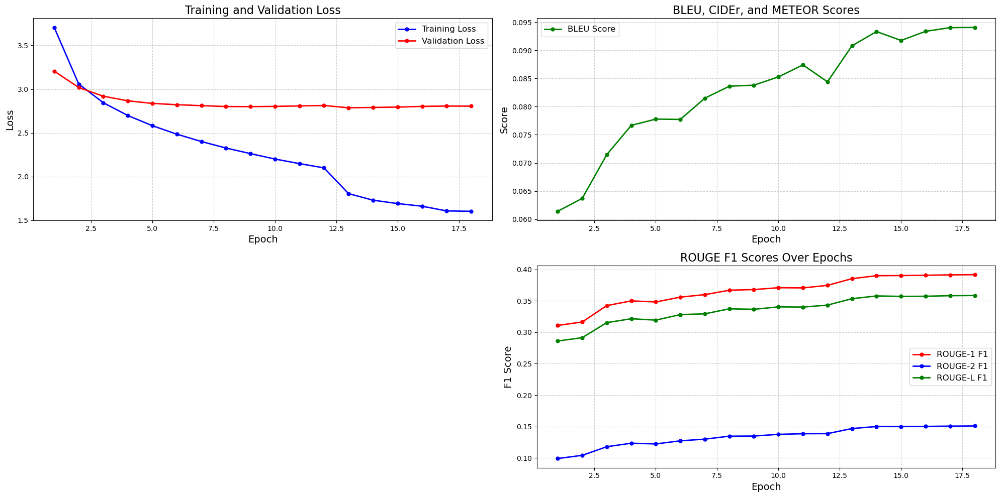

In [19]:
from src.utils import train_model

train_model(
    model=model_Attention,
    train_loader=train_loader,
    val_loader=val_loader,
    test_loader=test_loader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    vocab=vocab,
    vocab_builder=vocab_builder,
    num_epochs=num_epochs,
    print_every=print_every,
    early_stopping=early_stopping,
    save_dir=save_dir,
    device=device,
    Transform_mean=mean,
    Transform_std=std,
    model_name="LSTM_with_Attention",
    max_sentence_length=max_sentence_length,
    encoder_backbone=backbone,
    transformation_type=transformation
)

### Different Hyperparameter - dec_hidden_size=1024, Attention Size=128

In [20]:
vocab_size = len(vocab_builder.vocabulary)

emb_size = 300

attn_size = 128
drop_prob = 0.3
enc_hidden_size = 2048
dec_hidden_size = 1024

learning_rate = 1e-3
num_epochs = 100
print_every = 400

weight_decay = 1e-5

backbone="resnet50"  #"efficientnet"

#transformation="conv2d"
#transformation="linear"
transformation=None

save_dir = "saved_model"

In [21]:
from src.models.encoderdecoder import EncoderDecoder

model_Attention = EncoderDecoder(
    emb_size = emb_size,
    vocab_size = vocab_size,
    attn_size = attn_size,
    enc_hidden_size = enc_hidden_size,
    dec_hidden_size = dec_hidden_size,
    drop_prob = drop_prob,
    device = device,
    use_attention=True,
    transformation=transformation
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index = vocab['<pad>'])
optimizer = optim.Adam(model_Attention.parameters(), lr = learning_rate, weight_decay=weight_decay)

In [22]:
from src.utils import EarlyStopping

earlystopping_patience = 4

LR_patience = 2
LR_factor = 0.1


early_stopping = EarlyStopping(patience=earlystopping_patience, min_delta=0.001)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=LR_factor, patience=LR_patience, verbose=True)

Epoch: 1, Batch: 400, Training Loss: 3.63821


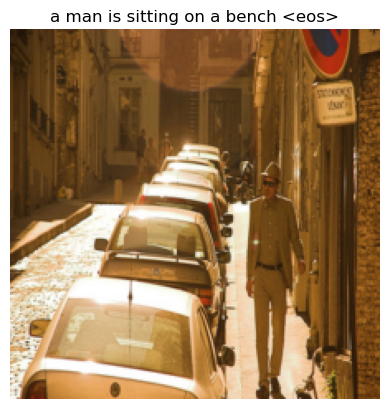

Epoch: 1, Batch: 800, Training Loss: 3.52200


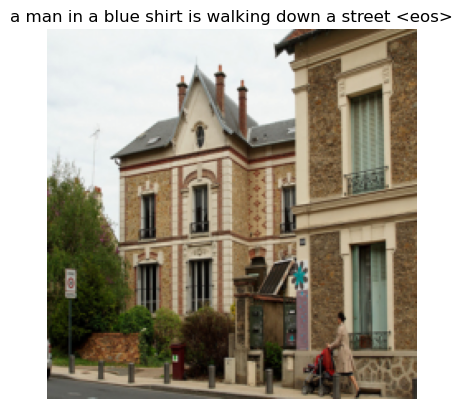

Epoch 1/100 - Train Loss: 3.7064, Val Loss: 3.2126, BLEU: 0.0622, ROUGE-1 Precision: 0.3343, ROUGE-1 Recall: 0.3248, ROUGE-1 F1: 0.3151, ROUGE-2 Precision: 0.1082, ROUGE-2 Recall: 0.1028, ROUGE-2 F1: 0.1003, ROUGE-L Precision: 0.3046, ROUGE-L Recall: 0.2992, ROUGE-L F1: 0.2887
Saved checkpoint for epoch 1 at saved_model\LSTM_with_Attention_resnet50_None_epoch_1.pth.gz
Epoch: 2, Batch: 400, Training Loss: 3.20381


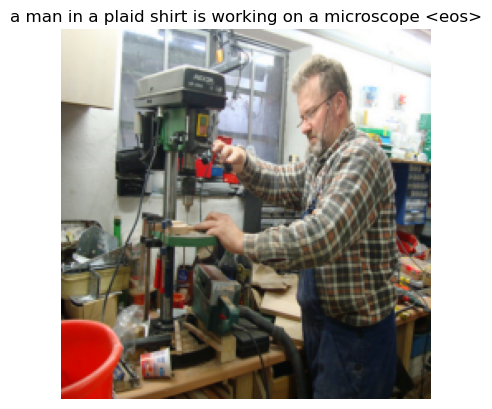

Epoch: 2, Batch: 800, Training Loss: 2.94113


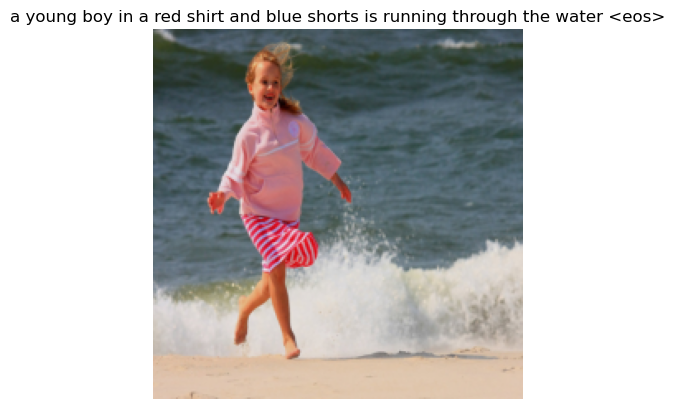

Epoch 2/100 - Train Loss: 3.0627, Val Loss: 3.0140, BLEU: 0.0668, ROUGE-1 Precision: 0.3758, ROUGE-1 Recall: 0.3287, ROUGE-1 F1: 0.3362, ROUGE-2 Precision: 0.1289, ROUGE-2 Recall: 0.1111, ROUGE-2 F1: 0.1138, ROUGE-L Precision: 0.3453, ROUGE-L Recall: 0.3045, ROUGE-L F1: 0.3102
Saved checkpoint for epoch 2 at saved_model\LSTM_with_Attention_resnet50_None_epoch_2.pth.gz
Epoch: 3, Batch: 400, Training Loss: 2.87371


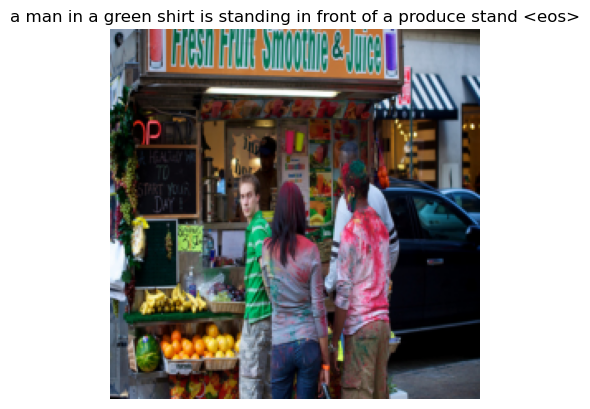

Epoch: 3, Batch: 800, Training Loss: 2.83402


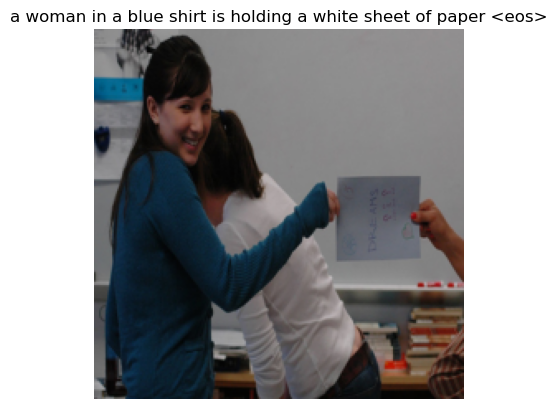

Epoch 3/100 - Train Loss: 2.8490, Val Loss: 2.9229, BLEU: 0.0725, ROUGE-1 Precision: 0.3715, ROUGE-1 Recall: 0.3414, ROUGE-1 F1: 0.3409, ROUGE-2 Precision: 0.1296, ROUGE-2 Recall: 0.1165, ROUGE-2 F1: 0.1171, ROUGE-L Precision: 0.3396, ROUGE-L Recall: 0.3145, ROUGE-L F1: 0.3128
Saved checkpoint for epoch 3 at saved_model\LSTM_with_Attention_resnet50_None_epoch_3.pth.gz
Epoch: 4, Batch: 400, Training Loss: 2.60719


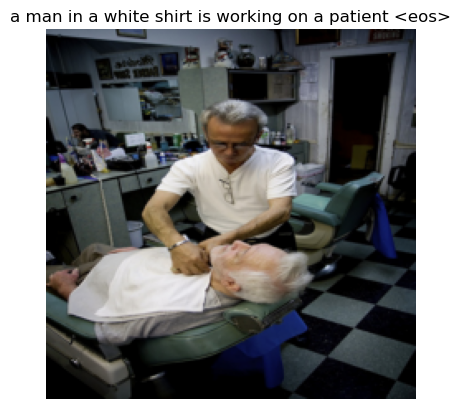

Epoch: 4, Batch: 800, Training Loss: 2.69194


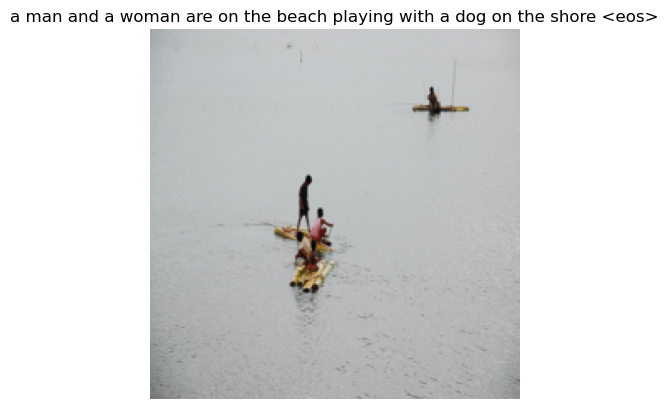

Epoch 4/100 - Train Loss: 2.7063, Val Loss: 2.8679, BLEU: 0.0781, ROUGE-1 Precision: 0.3675, ROUGE-1 Recall: 0.3595, ROUGE-1 F1: 0.3476, ROUGE-2 Precision: 0.1314, ROUGE-2 Recall: 0.1271, ROUGE-2 F1: 0.1229, ROUGE-L Precision: 0.3341, ROUGE-L Recall: 0.3297, ROUGE-L F1: 0.3173
Saved checkpoint for epoch 4 at saved_model\LSTM_with_Attention_resnet50_None_epoch_4.pth.gz
Epoch: 5, Batch: 400, Training Loss: 2.61699


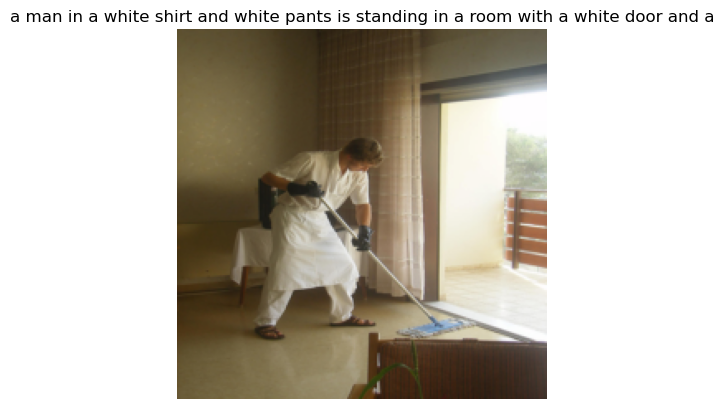

Epoch: 5, Batch: 800, Training Loss: 2.76983


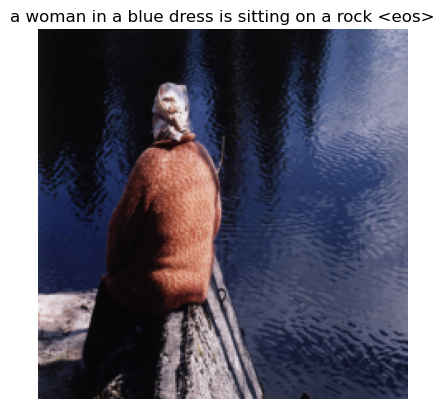

Epoch 5/100 - Train Loss: 2.5923, Val Loss: 2.8396, BLEU: 0.0765, ROUGE-1 Precision: 0.3762, ROUGE-1 Recall: 0.3576, ROUGE-1 F1: 0.3498, ROUGE-2 Precision: 0.1338, ROUGE-2 Recall: 0.1254, ROUGE-2 F1: 0.1229, ROUGE-L Precision: 0.3432, ROUGE-L Recall: 0.3287, ROUGE-L F1: 0.3202
Saved checkpoint for epoch 5 at saved_model\LSTM_with_Attention_resnet50_None_epoch_5.pth.gz
Epoch: 6, Batch: 400, Training Loss: 2.56965


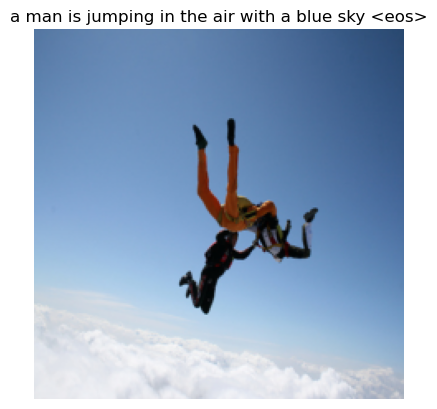

Epoch: 6, Batch: 800, Training Loss: 2.54641


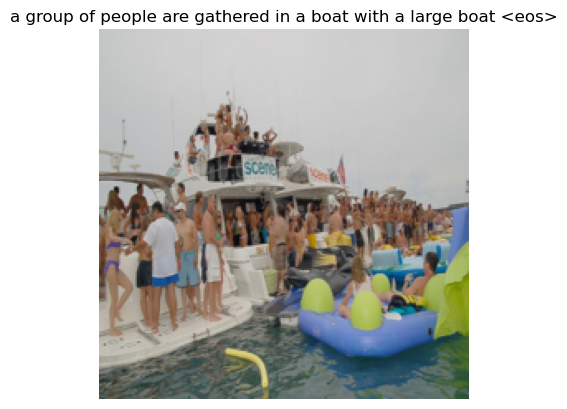

Epoch 6/100 - Train Loss: 2.4956, Val Loss: 2.8193, BLEU: 0.0806, ROUGE-1 Precision: 0.3750, ROUGE-1 Recall: 0.3687, ROUGE-1 F1: 0.3547, ROUGE-2 Precision: 0.1362, ROUGE-2 Recall: 0.1325, ROUGE-2 F1: 0.1275, ROUGE-L Precision: 0.3417, ROUGE-L Recall: 0.3384, ROUGE-L F1: 0.3243
Saved checkpoint for epoch 6 at saved_model\LSTM_with_Attention_resnet50_None_epoch_6.pth.gz
Epoch: 7, Batch: 400, Training Loss: 2.38353


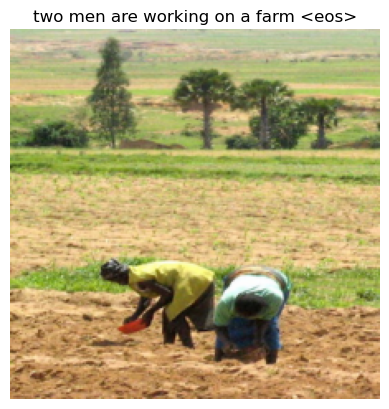

Epoch: 7, Batch: 800, Training Loss: 2.51277


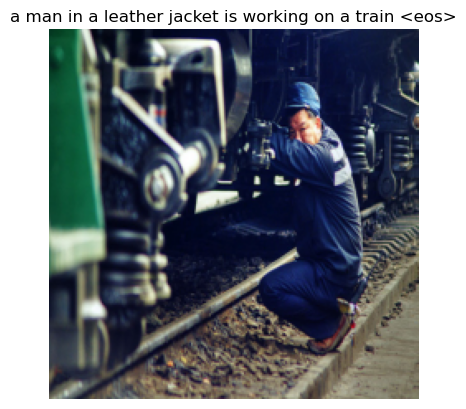

Epoch 7/100 - Train Loss: 2.4131, Val Loss: 2.8140, BLEU: 0.0807, ROUGE-1 Precision: 0.3925, ROUGE-1 Recall: 0.3682, ROUGE-1 F1: 0.3624, ROUGE-2 Precision: 0.1446, ROUGE-2 Recall: 0.1342, ROUGE-2 F1: 0.1321, ROUGE-L Precision: 0.3585, ROUGE-L Recall: 0.3388, ROUGE-L F1: 0.3321
Saved checkpoint for epoch 7 at saved_model\LSTM_with_Attention_resnet50_None_epoch_7.pth.gz
Epoch: 8, Batch: 400, Training Loss: 2.34791


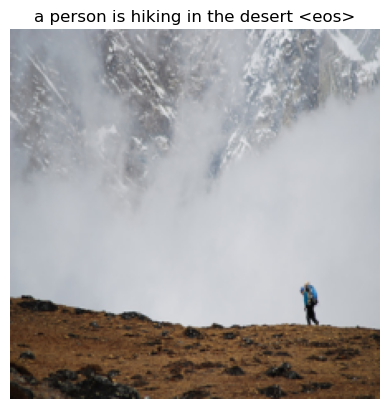

Epoch: 8, Batch: 800, Training Loss: 2.45707


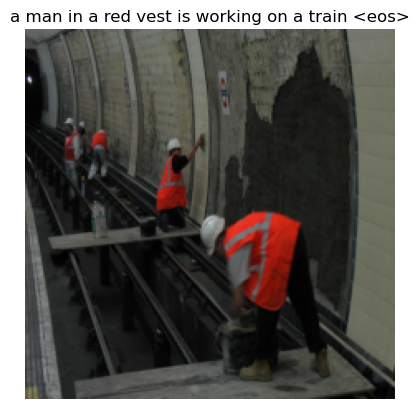

Epoch 8/100 - Train Loss: 2.3398, Val Loss: 2.8015, BLEU: 0.0842, ROUGE-1 Precision: 0.3869, ROUGE-1 Recall: 0.3754, ROUGE-1 F1: 0.3643, ROUGE-2 Precision: 0.1431, ROUGE-2 Recall: 0.1366, ROUGE-2 F1: 0.1330, ROUGE-L Precision: 0.3529, ROUGE-L Recall: 0.3453, ROUGE-L F1: 0.3337
Saved checkpoint for epoch 8 at saved_model\LSTM_with_Attention_resnet50_None_epoch_8.pth.gz
Epoch: 9, Batch: 400, Training Loss: 2.19634


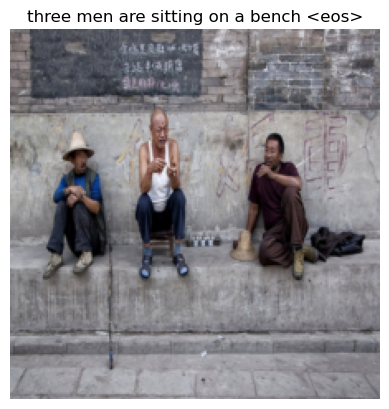

Epoch: 9, Batch: 800, Training Loss: 2.24399


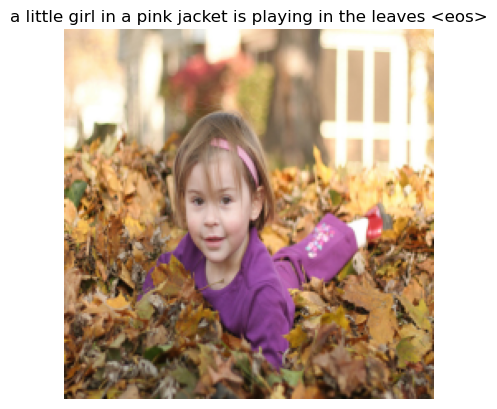

Epoch 9/100 - Train Loss: 2.2732, Val Loss: 2.7972, BLEU: 0.0849, ROUGE-1 Precision: 0.3985, ROUGE-1 Recall: 0.3742, ROUGE-1 F1: 0.3687, ROUGE-2 Precision: 0.1486, ROUGE-2 Recall: 0.1380, ROUGE-2 F1: 0.1361, ROUGE-L Precision: 0.3640, ROUGE-L Recall: 0.3442, ROUGE-L F1: 0.3380
Saved checkpoint for epoch 9 at saved_model\LSTM_with_Attention_resnet50_None_epoch_9.pth.gz
Epoch: 10, Batch: 400, Training Loss: 2.21394


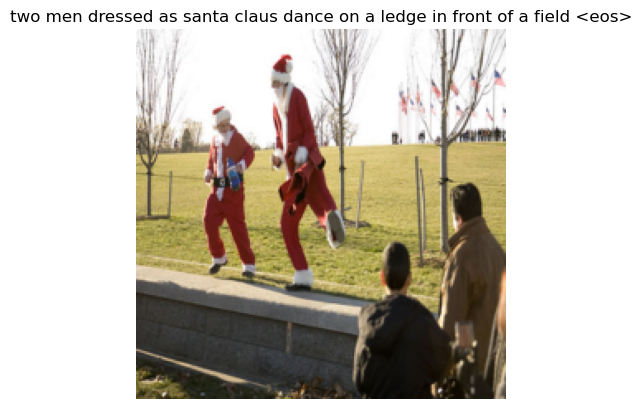

Epoch: 10, Batch: 800, Training Loss: 2.23333


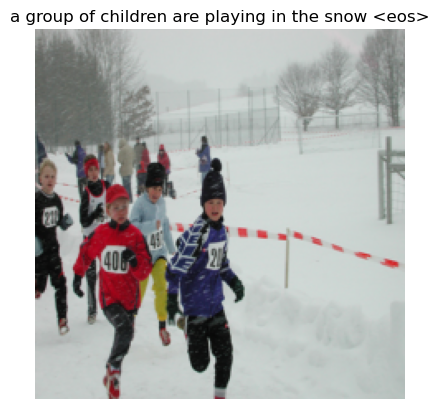

Epoch 10/100 - Train Loss: 2.2148, Val Loss: 2.8019, BLEU: 0.0855, ROUGE-1 Precision: 0.3988, ROUGE-1 Recall: 0.3756, ROUGE-1 F1: 0.3696, ROUGE-2 Precision: 0.1495, ROUGE-2 Recall: 0.1390, ROUGE-2 F1: 0.1370, ROUGE-L Precision: 0.3649, ROUGE-L Recall: 0.3459, ROUGE-L F1: 0.3392
Saved checkpoint for epoch 10 at saved_model\LSTM_with_Attention_resnet50_None_epoch_10.pth.gz
Epoch: 11, Batch: 400, Training Loss: 2.20538


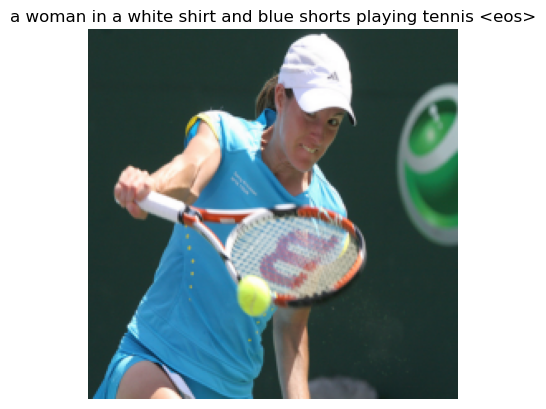

Epoch: 11, Batch: 800, Training Loss: 2.30137


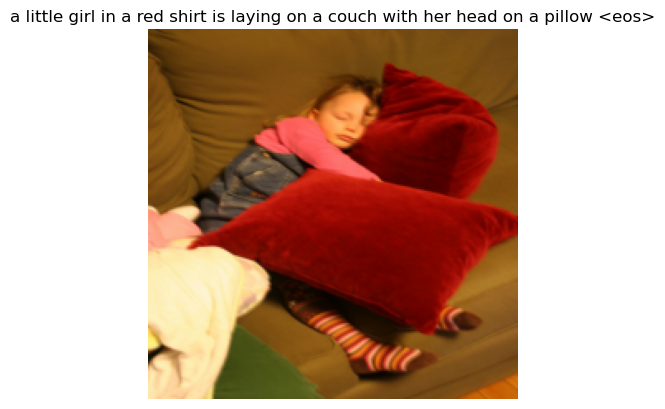

Epoch 11/100 - Train Loss: 2.1626, Val Loss: 2.7998, BLEU: 0.0855, ROUGE-1 Precision: 0.3983, ROUGE-1 Recall: 0.3822, ROUGE-1 F1: 0.3722, ROUGE-2 Precision: 0.1491, ROUGE-2 Recall: 0.1416, ROUGE-2 F1: 0.1380, ROUGE-L Precision: 0.3632, ROUGE-L Recall: 0.3512, ROUGE-L F1: 0.3407
Saved checkpoint for epoch 11 at saved_model\LSTM_with_Attention_resnet50_None_epoch_11.pth.gz
Epoch: 12, Batch: 400, Training Loss: 2.06077


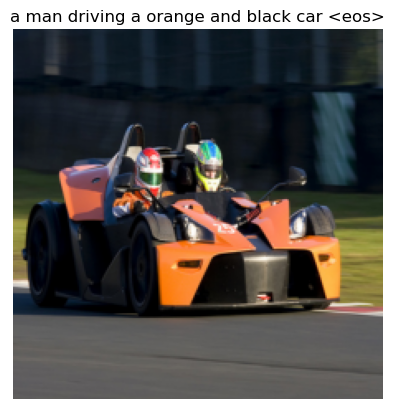

Epoch: 12, Batch: 800, Training Loss: 2.19685


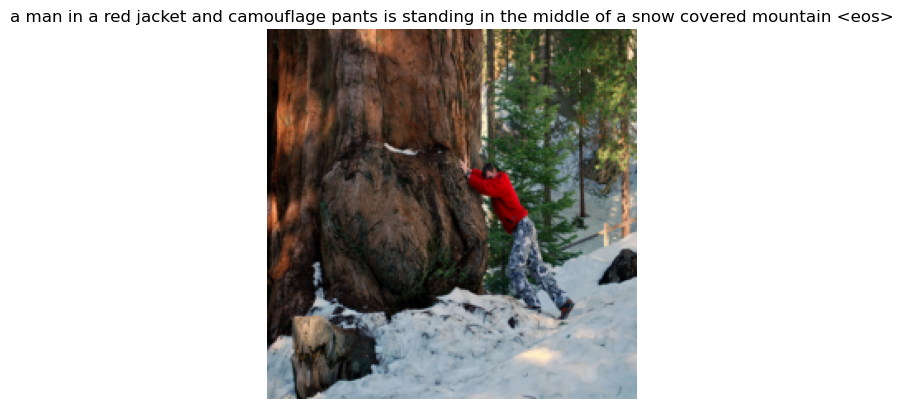

Epoch 12/100 - Train Loss: 2.1136, Val Loss: 2.8098, BLEU: 0.0839, ROUGE-1 Precision: 0.4108, ROUGE-1 Recall: 0.3751, ROUGE-1 F1: 0.3745, ROUGE-2 Precision: 0.1553, ROUGE-2 Recall: 0.1398, ROUGE-2 F1: 0.1397, ROUGE-L Precision: 0.3768, ROUGE-L Recall: 0.3464, ROUGE-L F1: 0.3446
Epoch 00012: reducing learning rate of group 0 to 1.0000e-04.
Saved checkpoint for epoch 12 at saved_model\LSTM_with_Attention_resnet50_None_epoch_12.pth.gz
Epoch: 13, Batch: 400, Training Loss: 1.85296


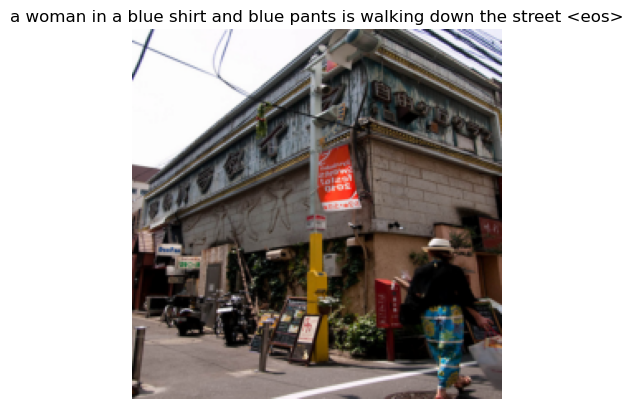

Epoch: 13, Batch: 800, Training Loss: 1.80404


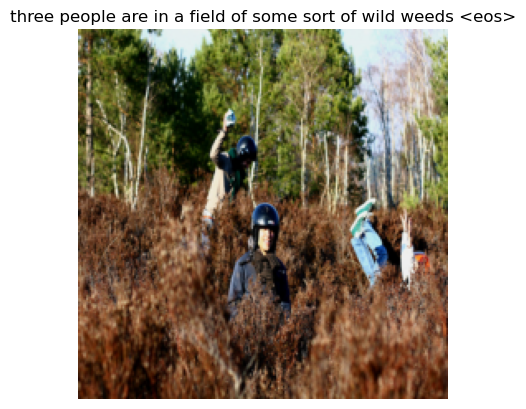

Epoch 13/100 - Train Loss: 1.8231, Val Loss: 2.7798, BLEU: 0.0917, ROUGE-1 Precision: 0.4164, ROUGE-1 Recall: 0.3936, ROUGE-1 F1: 0.3867, ROUGE-2 Precision: 0.1614, ROUGE-2 Recall: 0.1509, ROUGE-2 F1: 0.1484, ROUGE-L Precision: 0.3803, ROUGE-L Recall: 0.3619, ROUGE-L F1: 0.3543
Saved checkpoint for epoch 13 at saved_model\LSTM_with_Attention_resnet50_None_epoch_13.pth.gz
Epoch: 14, Batch: 400, Training Loss: 1.69930


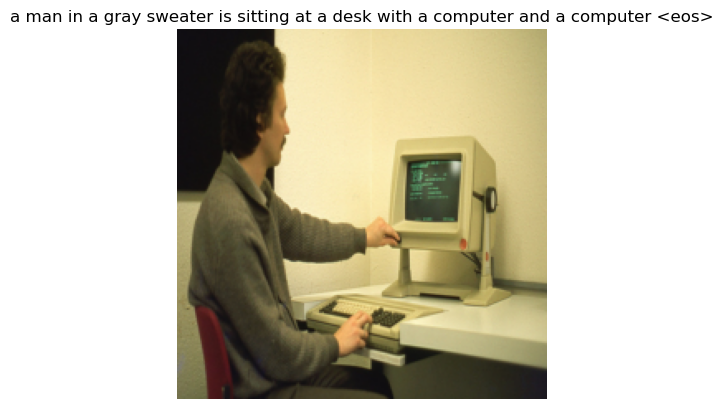

Epoch: 14, Batch: 800, Training Loss: 1.93044


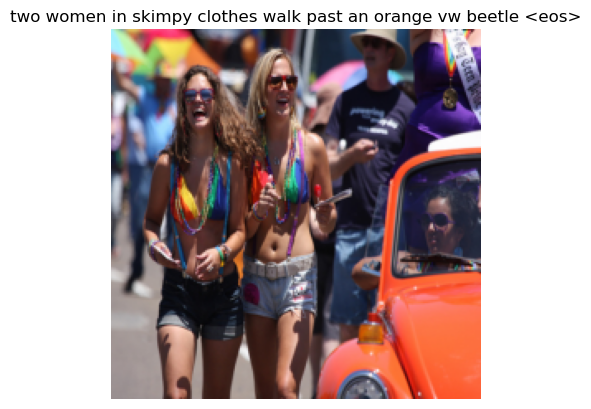

Epoch 14/100 - Train Loss: 1.7521, Val Loss: 2.7864, BLEU: 0.0938, ROUGE-1 Precision: 0.4177, ROUGE-1 Recall: 0.3985, ROUGE-1 F1: 0.3896, ROUGE-2 Precision: 0.1628, ROUGE-2 Recall: 0.1543, ROUGE-2 F1: 0.1507, ROUGE-L Precision: 0.3810, ROUGE-L Recall: 0.3658, ROUGE-L F1: 0.3564
Saved checkpoint for epoch 14 at saved_model\LSTM_with_Attention_resnet50_None_epoch_14.pth.gz
Epoch: 15, Batch: 400, Training Loss: 1.71242


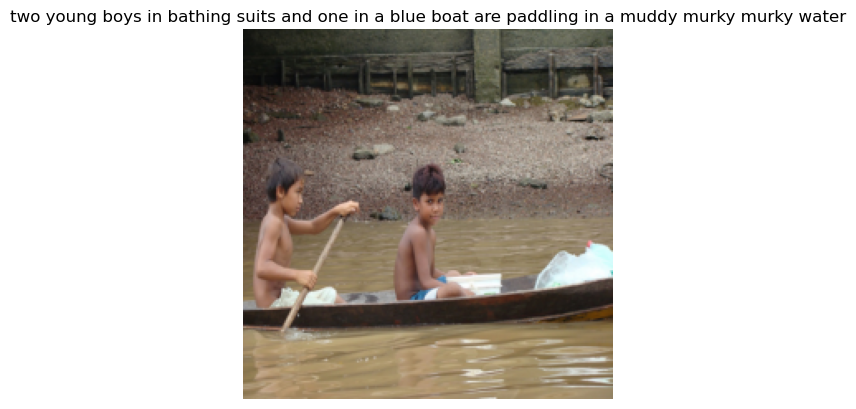

Epoch: 15, Batch: 800, Training Loss: 1.59933


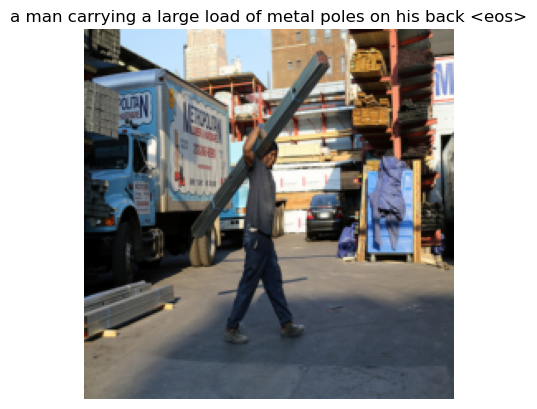

Epoch 15/100 - Train Loss: 1.7139, Val Loss: 2.7878, BLEU: 0.0946, ROUGE-1 Precision: 0.4178, ROUGE-1 Recall: 0.3998, ROUGE-1 F1: 0.3903, ROUGE-2 Precision: 0.1638, ROUGE-2 Recall: 0.1551, ROUGE-2 F1: 0.1515, ROUGE-L Precision: 0.3817, ROUGE-L Recall: 0.3675, ROUGE-L F1: 0.3576
Saved checkpoint for epoch 15 at saved_model\LSTM_with_Attention_resnet50_None_epoch_15.pth.gz
Epoch: 16, Batch: 400, Training Loss: 1.67185


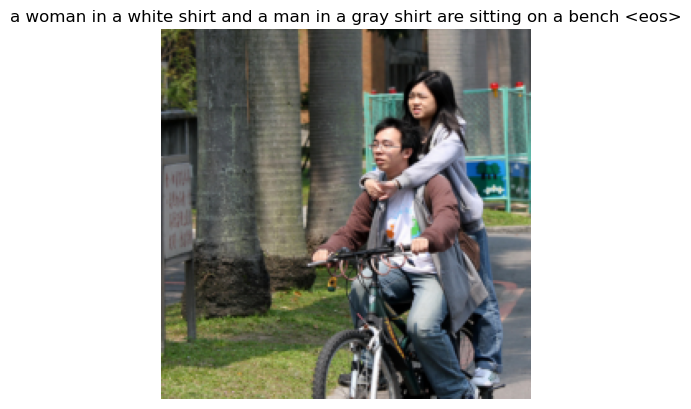

Epoch: 16, Batch: 800, Training Loss: 1.60806


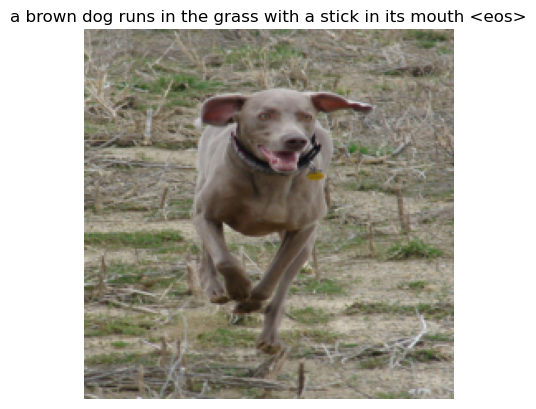

Epoch 16/100 - Train Loss: 1.6850, Val Loss: 2.7956, BLEU: 0.0943, ROUGE-1 Precision: 0.4198, ROUGE-1 Recall: 0.3996, ROUGE-1 F1: 0.3910, ROUGE-2 Precision: 0.1644, ROUGE-2 Recall: 0.1550, ROUGE-2 F1: 0.1517, ROUGE-L Precision: 0.3837, ROUGE-L Recall: 0.3673, ROUGE-L F1: 0.3583
Epoch 00016: reducing learning rate of group 0 to 1.0000e-05.
Saved checkpoint for epoch 16 at saved_model\LSTM_with_Attention_resnet50_None_epoch_16.pth.gz
Epoch: 17, Batch: 400, Training Loss: 1.62994


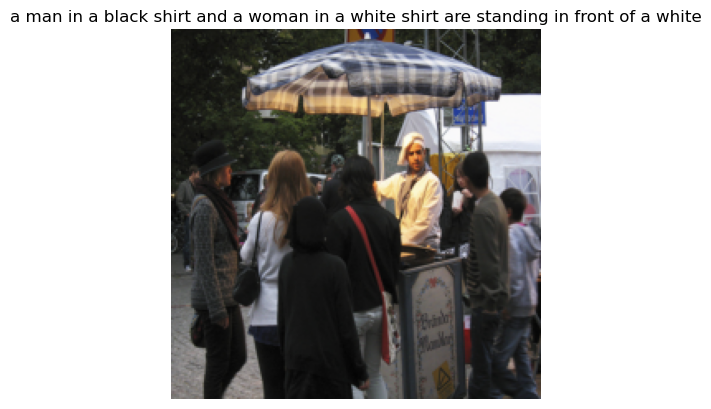

Epoch: 17, Batch: 800, Training Loss: 1.67747


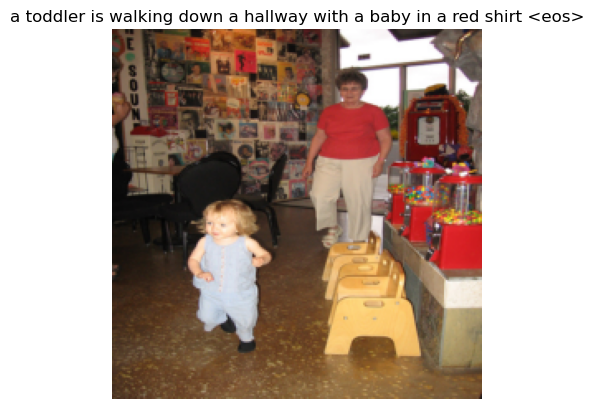

Epoch 17/100 - Train Loss: 1.6340, Val Loss: 2.7979, BLEU: 0.0943, ROUGE-1 Precision: 0.4208, ROUGE-1 Recall: 0.4017, ROUGE-1 F1: 0.3925, ROUGE-2 Precision: 0.1648, ROUGE-2 Recall: 0.1560, ROUGE-2 F1: 0.1525, ROUGE-L Precision: 0.3843, ROUGE-L Recall: 0.3691, ROUGE-L F1: 0.3595
Saved checkpoint for epoch 17 at saved_model\LSTM_with_Attention_resnet50_None_epoch_17.pth.gz
Epoch: 18, Batch: 400, Training Loss: 1.56756


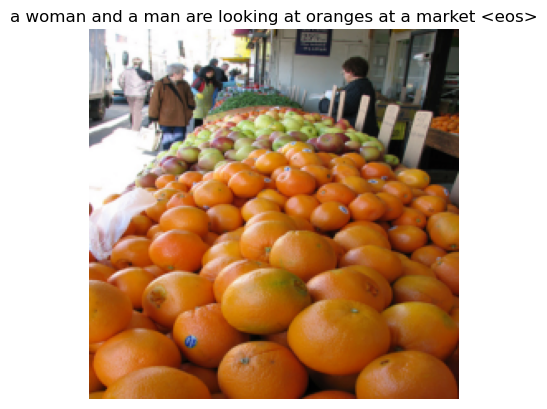

Epoch: 18, Batch: 800, Training Loss: 1.60579


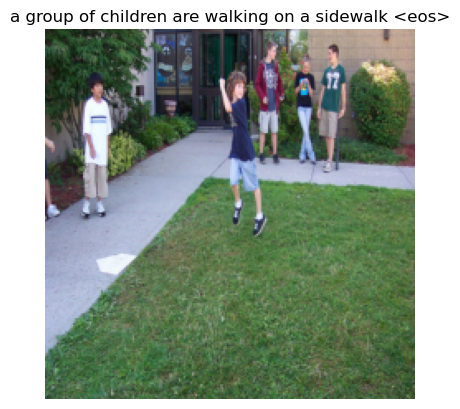

Epoch 18/100 - Train Loss: 1.6286, Val Loss: 2.7994, BLEU: 0.0939, ROUGE-1 Precision: 0.4190, ROUGE-1 Recall: 0.4019, ROUGE-1 F1: 0.3918, ROUGE-2 Precision: 0.1636, ROUGE-2 Recall: 0.1557, ROUGE-2 F1: 0.1517, ROUGE-L Precision: 0.3822, ROUGE-L Recall: 0.3689, ROUGE-L F1: 0.3584
Early stopping triggered after epoch 18
Evaluating on the test set...
Test Results - Loss: 2.7761, BLEU: 0.0927, ROUGE-1 F1: 0.3930, ROUGE-2 F1: 0.1526, ROUGE-L F1: 0.3600, 


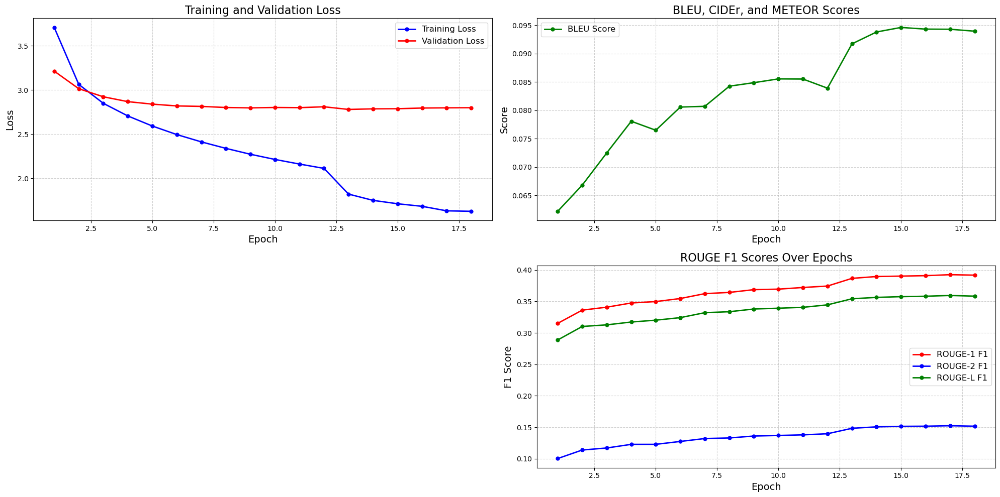

In [23]:
from src.utils import train_model

train_model(
    model=model_Attention,
    train_loader=train_loader,
    val_loader=val_loader,
    test_loader=test_loader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    vocab=vocab,
    vocab_builder=vocab_builder,
    num_epochs=num_epochs,
    print_every=print_every,
    early_stopping=early_stopping,
    save_dir=save_dir,
    device=device,
    Transform_mean=mean,
    Transform_std=std,
    model_name="LSTM_with_Attention",
    max_sentence_length=max_sentence_length,
    encoder_backbone=backbone,
    transformation_type=transformation
)

### Different Hyperparameter - dec_hidden_size=1024, Attention Size=128 - efficientnet

In [ ]:
vocab_size = len(vocab_builder.vocabulary)

emb_size = 300

attn_size = 128
drop_prob = 0.3
enc_hidden_size = 1280 #Same as efficientnet
dec_hidden_size = 1024

learning_rate = 1e-3
num_epochs = 100
print_every = 400

weight_decay = 1e-5

backbone="efficientnet"
transformation=None

save_dir = "saved_model"

In [23]:
from src.models.encoderdecoder import EncoderDecoder

model_Attention = EncoderDecoder(
    emb_size = emb_size,
    vocab_size = vocab_size,
    attn_size = attn_size,
    enc_hidden_size = enc_hidden_size,
    dec_hidden_size = dec_hidden_size,
    drop_prob = drop_prob,
    device = device,
    use_attention=True,
    backbone = backbone,
    transformation=transformation
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index = vocab['<pad>'])
optimizer = optim.Adam(model_Attention.parameters(), lr = learning_rate, weight_decay=weight_decay)

In [24]:
from src.utils import EarlyStopping

earlystopping_patience = 4

LR_patience = 2
LR_factor = 0.1


early_stopping = EarlyStopping(patience=earlystopping_patience, min_delta=0.001)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=LR_factor, patience=LR_patience, verbose=True)

Epoch: 1, Batch: 400, Training Loss: 3.63543


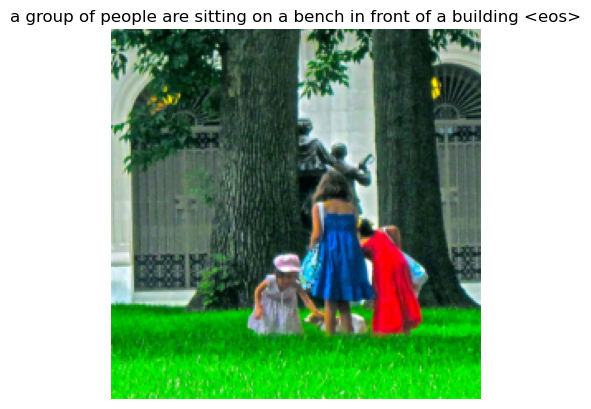

Epoch: 1, Batch: 800, Training Loss: 3.31512


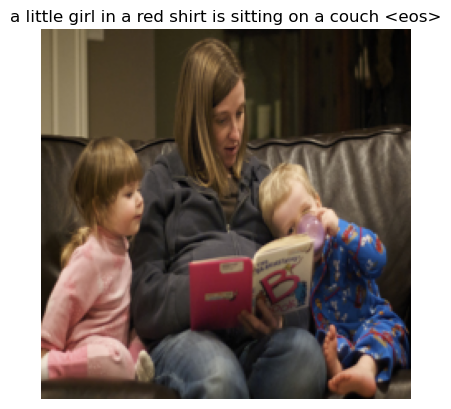

Epoch 1/100 - Train Loss: 3.7751, Val Loss: 3.2813, BLEU: 0.0546, ROUGE-1 Precision: 0.3111, ROUGE-1 Recall: 0.3089, ROUGE-1 F1: 0.2960, ROUGE-2 Precision: 0.0940, ROUGE-2 Recall: 0.0914, ROUGE-2 F1: 0.0880, ROUGE-L Precision: 0.2829, ROUGE-L Recall: 0.2838, ROUGE-L F1: 0.2706
Saved checkpoint for epoch 1 at saved_model\LSTM_with_Attention_efficientnet_None_epoch_1.pth.gz
Epoch: 2, Batch: 400, Training Loss: 3.12109


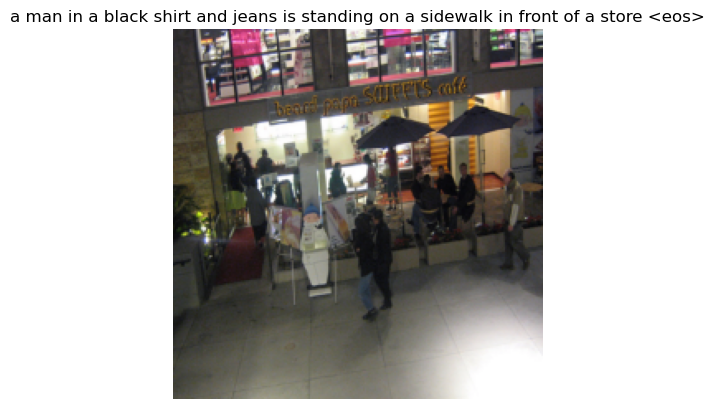

Epoch: 2, Batch: 800, Training Loss: 3.23336


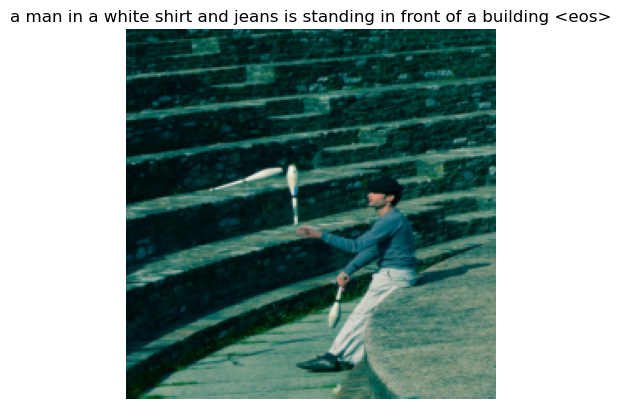

KeyboardInterrupt: 

In [25]:
from src.utils import train_model

train_model(
    model=model_Attention,
    train_loader=train_loader,
    val_loader=val_loader,
    test_loader=test_loader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    vocab=vocab,
    vocab_builder=vocab_builder,
    num_epochs=num_epochs,
    print_every=print_every,
    early_stopping=early_stopping,
    save_dir=save_dir,
    device=device,
    Transform_mean=mean,
    Transform_std=std,
    model_name="LSTM_with_Attention",
    max_sentence_length=max_sentence_length,
    encoder_backbone=backbone,
    transformation_type=transformation
)

## Generating captions from best model - Resnet50

In [22]:
import torch
from pathlib import Path
import os

if Path.cwd().name == 'notebooks':
    os.chdir("..")


from torchvision import transforms
from PIL import Image
from src.utils import load_model, display_image, visualize_attention
from src.models.encoderdecoder import EncoderDecoder
from src.vocab_builder import VocabularyBuilder

device = 'cuda' if torch.cuda.is_available() else 'cpu'

vocab_builder = VocabularyBuilder(min_freq=2, save_path='./saved_model/vocab_full.pth', special_token=True)
vocab = vocab_builder.load_vocab(device)

model_params = {
    "emb_size": 300,
    "vocab_size": len(vocab_builder.vocabulary),
    "attn_size": 128,
    "enc_hidden_size": 2048,
    "dec_hidden_size": 1024,
    "drop_prob": 0.3,
    "decoder_type": "lstm",
    "backbone": "resnet50",
    "transformation": None,
    "num_heads": None,
    "num_layers": None,
    "ff_dim": None,
    "max_len": 80,
    "use_attention": True,
    "device": device,
}

model = EncoderDecoder(**model_params)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


checkpoint_path = "./saved_model/LSTM_with_Attention_resnet50_None_epoch_15.pth.gz"
model, optimizer, start_epoch = load_model(model, optimizer, checkpoint_path, device=device)

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def generate_caption_for_image(image_path, visualize_atten=True):
    image = Image.open(image_path).convert("RGB")
    transformed_image = transform(image).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        features = model.encoder(transformed_image)
        generated_caption, attention_weights = model.decoder.generate_caption(features=features, vocab=vocab)

    caption_text = " ".join(generated_caption)
    print(f"Generated Caption: {caption_text}")

    display_image(transformed_image.squeeze(0).cpu(), caption=caption_text, denormalize=True)

    if attention_weights and visualize_atten:
        visualize_attention(
            image=transformed_image.squeeze(0).cpu(),
            caption=generated_caption,
            attention_weights=attention_weights,
            mean=torch.tensor([0.485, 0.456, 0.406]),
            std=torch.tensor([0.229, 0.224, 0.225]),
            decoder_type='lstm',
            denormalize=True
        )


Loaded model from epoch 15


Processing: 25-R10500-P1-030.jpg
Generated Caption: a crowd of people watching a man in a yellow shirt <eos>


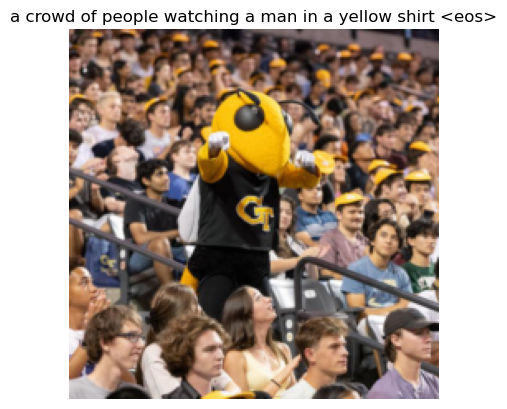

Processing: 53124280902_5077e9d833_w.jpg
Generated Caption: a young boy is sitting in a chair with a chair in his lap <eos>


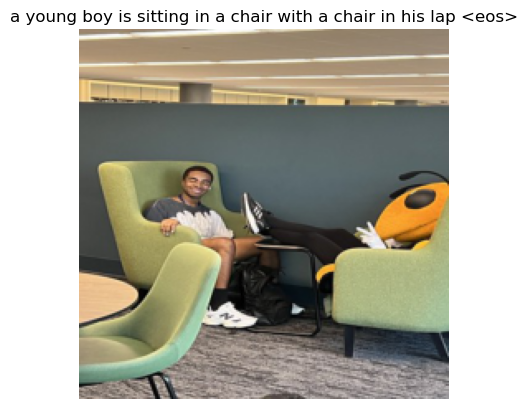

Processing: clough.jpg
Generated Caption: a man walking down a street <eos>


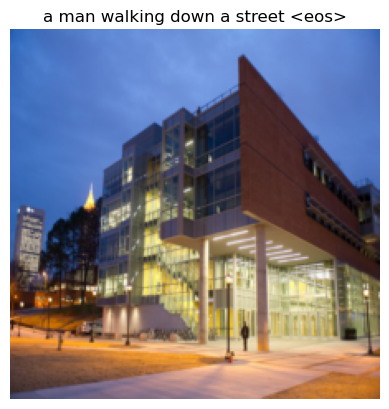

Processing: download.jpg
Generated Caption: a group of women with yellow shirts and yellow shirts pose for a picture <eos>


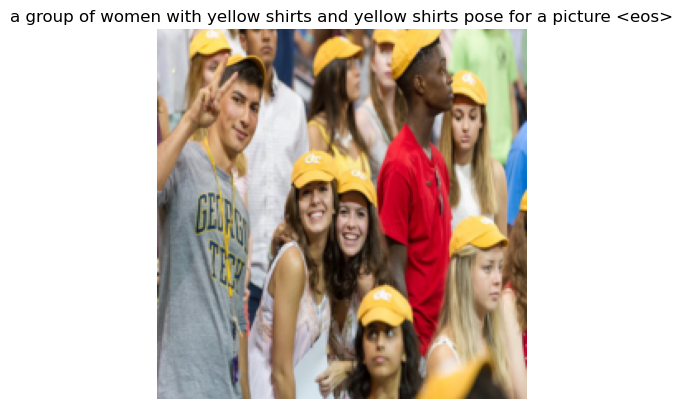

Processing: georgia tech georgia.jpg
Generated Caption: a football player in a red uniform is running with the ball while another player in a white jersey is running <eos>


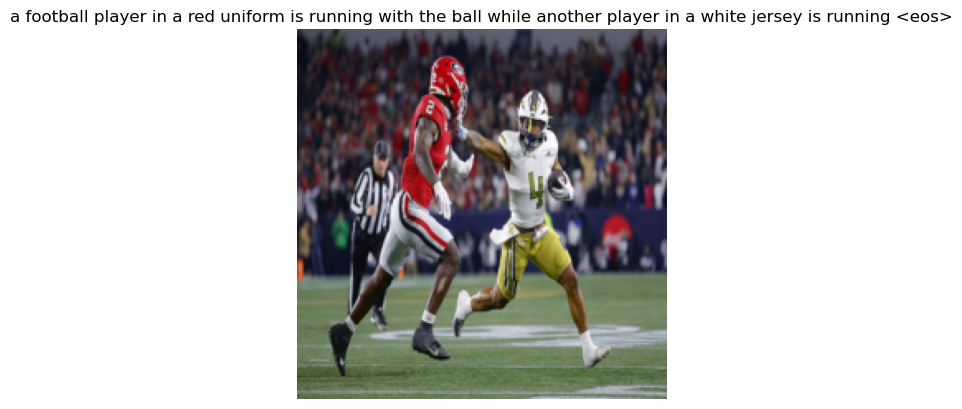

Processing: img_8914.jpg
Generated Caption: a group of people are sitting on a bench in a room <eos>


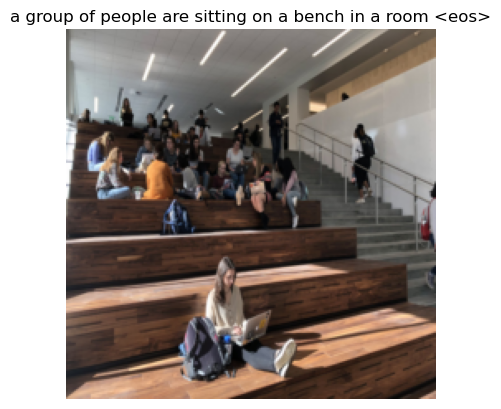

Processing: jumping1.jpg
Generated Caption: a group of young people holding up their hands in the air <eos>


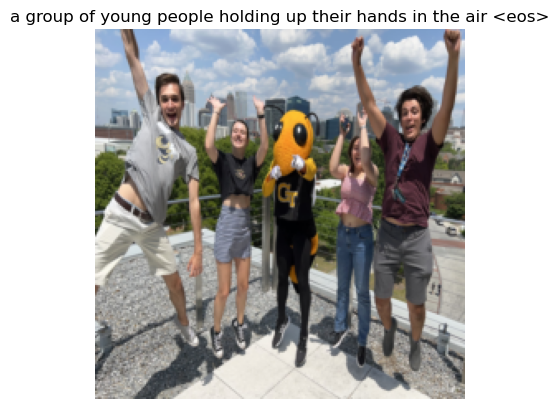

In [ ]:
import os

folder_path = "./data/my_test/"

for image_file in os.listdir(folder_path):
    if image_file.endswith(".jpg"): 
        image_path = os.path.join(folder_path, image_file)
        print(f"Processing: {image_file}")
        generate_caption_for_image(image_path, visualize_atten=False)

## Generating captions from best model - Efficientnet

In [27]:
import torch
from pathlib import Path
import os

if Path.cwd().name == 'notebooks':
    os.chdir("..")


from torchvision import transforms
from PIL import Image
from src.utils import load_model, display_image, visualize_attention
from src.models.encoderdecoder import EncoderDecoder
from src.vocab_builder import VocabularyBuilder

device = 'cuda' if torch.cuda.is_available() else 'cpu'

vocab_builder = VocabularyBuilder(min_freq=2, save_path='./saved_model/vocab_full.pth', special_token=True)
vocab = vocab_builder.load_vocab(device)

model_params = {
    "emb_size": 300,
    "vocab_size": len(vocab_builder.vocabulary),
    "attn_size": 128,
    "enc_hidden_size": 1280,
    "dec_hidden_size": 1024,
    "drop_prob": 0.3,
    "decoder_type": "lstm",
    "backbone": "efficientnet",
    "transformation": None,
    "num_heads": None,
    "num_layers": None,
    "ff_dim": None,
    "max_len": 80,
    "use_attention": True,
    "device": device,
}


model = EncoderDecoder(**model_params)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


checkpoint_path = "./saved_model/LSTM_with_Attention_efficientnet_None_epoch_1.pth.gz"
model, optimizer, start_epoch = load_model(model, optimizer, checkpoint_path, device=device)

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def generate_caption_for_image(image_path, visualize_atten=True):
    image = Image.open(image_path).convert("RGB")
    transformed_image = transform(image).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        features = model.encoder(transformed_image)
        generated_caption, attention_weights = model.decoder.generate_caption(features=features, vocab=vocab)

    caption_text = " ".join(generated_caption)
    print(f"Generated Caption: {caption_text}")

    display_image(transformed_image.squeeze(0).cpu(), caption=caption_text, denormalize=True)

    if attention_weights and visualize_atten:
        visualize_attention(
            image=transformed_image.squeeze(0).cpu(),
            caption=generated_caption,
            attention_weights=attention_weights,
            mean=torch.tensor([0.485, 0.456, 0.406]),
            std=torch.tensor([0.229, 0.224, 0.225]),
            decoder_type='lstm',
            denormalize=True
        )


Loaded model from epoch 1


Processing: 25-R10500-P1-030.jpg
Generated Caption: a group of people are playing basketball <eos>


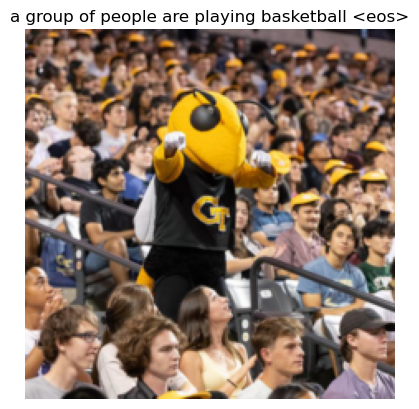

Processing: 53124280902_5077e9d833_w.jpg
Generated Caption: a young boy in a blue shirt is sitting on a chair <eos>


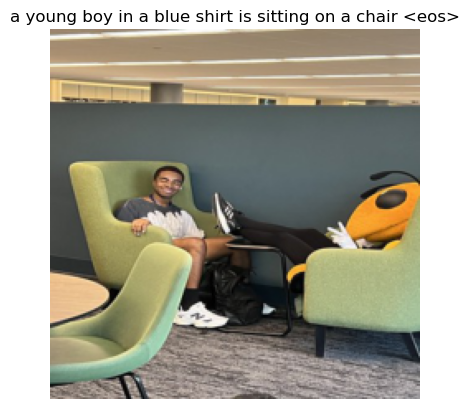

Processing: clough.jpg
Generated Caption: a man in a yellow shirt is walking on a sidewalk <eos>


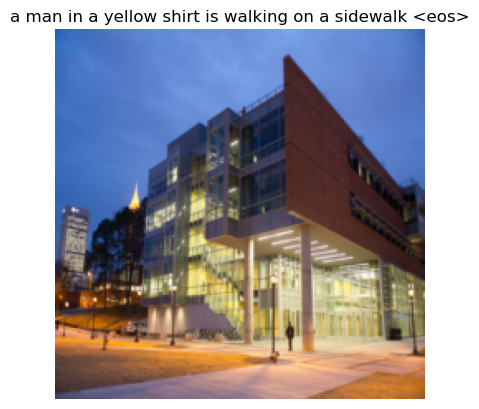

Processing: download.jpg
Generated Caption: a young girl in a yellow shirt and a red hat is holding a yellow umbrella <eos>


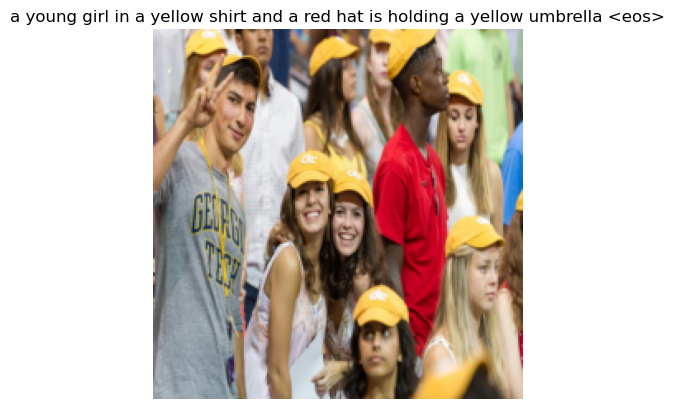

Processing: georgia tech georgia.jpg
Generated Caption: a football player in a red jersey is running <eos>


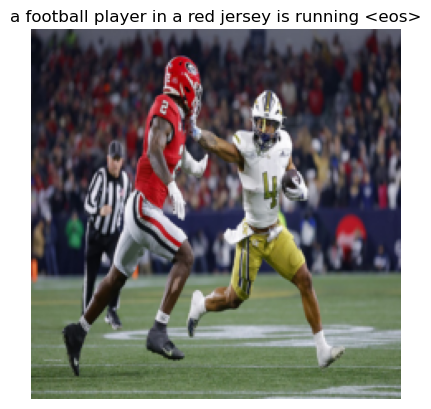

Processing: img_8914.jpg
Generated Caption: a man in a black shirt and black pants is sitting on a bench <eos>


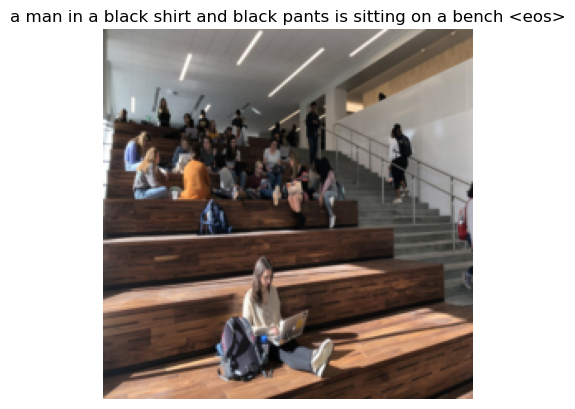

Processing: jumping1.jpg
Generated Caption: a group of people are walking on a sidewalk <eos>


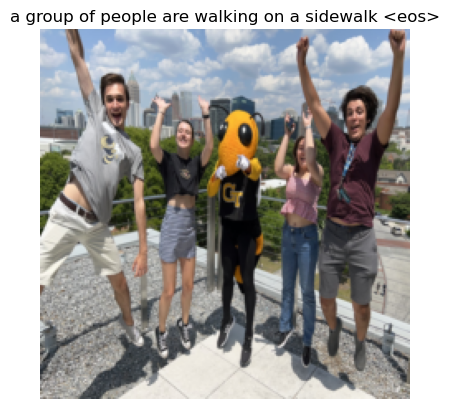

In [28]:
import os

folder_path = "./data/my_test/"

for image_file in os.listdir(folder_path):
    if image_file.endswith(".jpg"): 
        image_path = os.path.join(folder_path, image_file)
        print(f"Processing: {image_file}")
        generate_caption_for_image(image_path, visualize_atten=False)